# DigitalSreeni's Python Basic tutorial

Youtube: <a href='https://www.youtube.com/playlist?list=PLZsOBAyNTZwYHBIlu_PUO19M7aHMgwBJr'>Python tutorials for image processing and machine learning</a>

Github:<a href='https://github。com/bnsreenu/python_for_microscopists'>
Python for Microscopists and other image processing enthusiasts</a>

These tutorials are intended for beginners, students, researchers and
who are learning who are beginning Pythonprogrammers.


# Environment Setup
為了這個計畫能夠更不受電腦限制，我將在Google Colab這個IDE執行，並將檔案(程式、影像)放在Google Drive上面。

同時我想更進一步與Github同步，由於目前尚未找到GDrive與Github的直接同步辦法，我利用了GDrive電腦版同步到local，再用VSCode與Github的同步。

在local端一些功能無法在Colab實現，以及Colab需要與GDrive做連結，連同函式庫的匯入，都一併在環境建置執行。

---
In order to make this project less restricted by computer limitations, I will be using the IDE Google Colab and storing the files (code, images) on Google Drive.

At the same time, I would like to further synchronize with Github. Since there is currently no direct synchronization method between GDrive and Github, I have used the GDrive desktop version to synchronize to local, and then used VSCode to synchronize with Github.

Some features cannot be implemented on Colab's local end, and Colab needs to be linked with GDrive, so the environment setup will include importing libraries.



In [ ]:
from google.colab import drive
import os
drive.mount('/content/gdrive')
path = r'/content/gdrive/My Drive/Colab Notebooks/screeni_practice'
os.chdir( path )

Mounted at /content/gdrive


In [3]:
import glob
import numpy as np
import csv
from scipy import ndimage, misc, stats

In [2]:
import cv2
# import czifile
import matplotlib.pyplot as plt
from skimage import io, img_as_float, img_as_ubyte, restoration, segmentation
from PIL import Image
from google.colab.patches import cv2_imshow

from skimage.transform import rescale, resize, downscale_local_mean
from skimage.feature import canny
from skimage.filters import roberts, sobel, scharr, prewitt, threshold_otsu
from skimage.filters.rank import entropy
from skimage.morphology import disk
from skimage.restoration import denoise_nl_means, estimate_sigma

# Contets
Introduction Programming

Python basics

Image Processing
*   Basic
*   Libraries
*   OpenCV
*   Analysis

Data Processing
*   Basic

Machine Learning
*   Regressin
*   Clustering

# Introduction Programming

## <a href='https://www.youtube.com/watch?v=X_pCiVQ4c4E'>01 - Why do you need to learn programming?</a>

## <a href='https://www.youtube.com/watch?v=6meYJsjr6gA'>02 - What is programming?</a>

## <a href='https://www.youtube.com/watch?v=AzuajQnRuGI'>03 - What is command prompt?</a>

## <a href='https://www.youtube.com/watch?v=_xIcIrdIqlA'>04 - What is a digital image?</a>

## <a href='https://www.youtube.com/watch?v=qgJLeDPT8UM'>05 - What is Python?</a>

# Python basics


## <a href='https://www.youtube.com/watch?v=BxebisJKWBg'>06 - Python basics - IDE & operators</a>
1.  variable type assign variable calculate

## <a href='https://www.youtube.com/watch?v=sSgUulx1xq4'>07 - Python basics - logical operators and basic math</a>


In [ ]:
print('Hello World')
print('My 2nd line')

Hello World
My 2nd line


In [ ]:
a = 5
b = 3.0
c = a*b
d = 'hello'
a*d


'hellohellohellohellohello'

In [ ]:
e = 'world'
d+e

'helloworld'

In [ ]:
a**b

125.0

In [ ]:
f = -5
abs(f)

5

In [ ]:
round(a/b)

2

## <a href='https://www.youtube.com/watch?v=aoS9GWod4c8'>08 - A warning about round off errors in Python</a>

1.  小數位用2進制表示的浮點問題

In [ ]:
(1/45)*45

1.0

In [ ]:
(1/49)*49

0.9999999999999999

In [ ]:
0.1+0.2

0.30000000000000004

## <a href='https://www.youtube.com/watch?v=VaoHGZ-rawQ'>09 - if else elif statements in Python</a>

1.  if vs elif vs else
2.  %d vs %i vs %f
3.  逐行執行

In [ ]:
num = int(input('Please enter an integer'))

if num >= 0:
  if num == 0:
    print('zero')
  else:
    print('%i is a positive number' %(num))
elif num == 0:
  print('%d is a zero' %(num))
else:
  print('%4.2f is a positive number' %(num))

Please enter an integer5
5 is a positive number


## <a href='https://www.youtube.com/watch?v=c83l59sx6tU'>10 - lists tuples and dictionaries</a>

1.  list can be n demensions entries
2.  tuple like list but cant change exit items
3.  dictionary like list, had key & value

In [ ]:
a = [1,2,3,4,5]
a[0]
b = a[1]
a[2] = 'str'
b = a.pop()
a.append('this is new')
a = list(range(10))
print(a[2:4])
print(a[2:])
print(a[:4])
a[2:4] = [21,22]
print(a)
b = [[2,3],[4,5]]
a*2

[2, 3]
[2, 3, 4, 5, 6, 7, 8, 9]
[0, 1, 2, 3]
[0, 1, 21, 22, 4, 5, 6, 7, 8, 9]


[0, 1, 21, 22, 4, 5, 6, 7, 8, 9, 0, 1, 21, 22, 4, 5, 6, 7, 8, 9]

In [ ]:
b = (1,2,3,4,5)
c = ('one', 'two', 'three')
d = b+c
print(d)
len(d)
max(a)
e = tuple(a)
f = list(b)

(1, 2, 3, 4, 5, 'one', 'two', 'three')


In [ ]:
fruit = {'banana': 'yellow', 'apple': 'red', 'pear': 'green'}
print(fruit['apple'])
fruit['grape'] = 'black'
print(fruit)
del fruit['apple']

red
{'banana': 'yellow', 'apple': 'red', 'pear': 'green', 'grape': 'black'}


## <a href='https://www.youtube.com/watch?v=4uFs1qouPEI'>11 - numpy arrays</a>
1.  numpy easier for matrix calculate

In [ ]:
a = [1, 2, 3, 4, 5, 6]
print(a*2)

square = []
for i in a:
  square.append(i**2)
  print(i**2)

print(square)

square = [i**2 for i in a]
print(square)

square = [i**2 for i in a if i%2 ==0]
print(square)

[1, 2, 3, 4, 5, 6, 1, 2, 3, 4, 5, 6]
1
4
9
16
25
36
[1, 4, 9, 16, 25, 36]
[1, 4, 9, 16, 25, 36]
[4, 16, 36]


In [ ]:
a = [1, 2, 3, 4, 5, 6]
b = np.array(a)
print(b)
print(type(b))
print(b*2)
print(b**2)

a = np.zeros((2,2))
print(a)

a = np.ones((2,2))
print(a)

a = np.full((2,2),5)
print(a)

a = np.eye(3)
print(a)

a = np.random.random((2,2))
print(a)

a = np.array([[1,2,3,4],[5,6,7,8,],[9,10,11,12]])
print(a)

b = a[:2]
print(b)

b = a[0:2]
print(b)

b = a[:, :2]
print(b)

b = a[:2, 1:3]
print(b)

a = np.array([[1,2],[3,4],[5,6]])
print(a)
print(np.array([a[0,0],a[1,1],a[2,0]]))



# c= [[1,2,3],[4,5,6]]
# b = np.array(c)
# print(b)

[1 2 3 4 5 6]
<class 'numpy.ndarray'>
[ 2  4  6  8 10 12]
[ 1  4  9 16 25 36]
[[0. 0.]
 [0. 0.]]
[[1. 1.]
 [1. 1.]]
[[5 5]
 [5 5]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[0.41729562 0.0589738 ]
 [0.60950317 0.00234635]]
[[ 1  2  3  4]
 [ 5  6  7  8]
 [ 9 10 11 12]]
[[1 2 3 4]
 [5 6 7 8]]
[[1 2 3 4]
 [5 6 7 8]]
[[ 1  2]
 [ 5  6]
 [ 9 10]]
[[2 3]
 [6 7]]
[[1 2]
 [3 4]
 [5 6]]
[1 4 5]


In [ ]:
x = np.array([[1,2],[3,4]], dtype=np.float64)
y = np.array([[5,6],[7,8]], dtype=np.float64)

print(x)
print(y)
print(x+y)

print(np.multiply(x,y))
print(x*y)

print(np.sum(x))
print(np.sum(x, axis=0))

print(x)
print(x.T)

a = np.array([[1,2,3],[4,5,6],[7,8,9,],[10,11,12]])
b = np.array([2,0,2])
c = a+b

print(c)

[[1. 2.]
 [3. 4.]]
[[5. 6.]
 [7. 8.]]
[[ 6.  8.]
 [10. 12.]]
[[ 5. 12.]
 [21. 32.]]
[[ 5. 12.]
 [21. 32.]]
10.0
[4. 6.]
[[1. 2.]
 [3. 4.]]
[[1. 3.]
 [2. 4.]]
[[ 3  2  5]
 [ 6  5  8]
 [ 9  8 11]
 [12 11 14]]


In [ ]:
#imread, imsave has been deprecated since SciPy 1.0
# use cv2 imread, imwrite
# cv2: BGR

img = cv2.imread('images/test_image.jpg')

print(img)
print(img.dtype, img.shape)
img_tinted = img * [0.,0.,1.]
cv2.imwrite('images/tinted.jpg', img_tinted)

[[[ 92  54  12]
  [126  93   0]
  [154 117   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 83  59  17]
  [113  89   7]
  [137 102   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 53  41  23]
  [ 83  67  14]
  [108  79   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[  3  26   0]
  [  2  23   0]
  [  3  21   0]
  ...
  [ 34  20   8]
  [ 14   8   3]
  [  2   3   1]]

 [[  8  45   0]
  [  7  39   0]
  [  9  33   0]
  ...
  [ 54  36  19]
  [ 30  18  12]
  [ 11   6   7]]

 [[ 14  66   2]
  [ 12  54   1]
  [  6  37   0]
  ...
  [ 71  49  13]
  [ 45  23  41]
  [ 14   7  20]]]
uint8 (513, 639, 3)


True

## <a href='https://www.youtube.com/watch?v=YfZQbujGvFY'>12 - Python Recap of lists and numpy arrays</a>

1.  python自動判斷變數型態
2.  tuple1不可變
3.  index從0開始
4.  numpy more sample
5.  lib= 不必重發明輪子


In [ ]:
# 觀察變數型態
a = 3
b = 5.
c = 'chan'
d = [1,2,3,4,5]

In [ ]:
d = [1, 'chan', 5.]

In [ ]:
e = (1,2,3,4,5)

In [ ]:
f = e[3]
f

4

In [ ]:
e = (1, 'chan', 5.)
e[2]

5.0

In [ ]:
print(d*2)
b = [i*2 for i in d]
print(b)

[1, 'chan', 5.0, 1, 'chan', 5.0]
[2, 'chanchan', 10.0]


In [ ]:
a = np.array([2,4,6,8])
print(a*2)
print(a**2)

[ 4  8 12 16]
[ 4 16 36 64]


In [ ]:
img = imread('images/test_image.jpg')
print(img)

[[[ 92  54  12]
  [126  93   0]
  [154 117   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 83  59  17]
  [113  89   7]
  [137 102   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 53  41  23]
  [ 83  67  14]
  [108  79   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[  3  26   0]
  [  2  23   0]
  [  3  21   0]
  ...
  [ 34  20   8]
  [ 14   8   3]
  [  2   3   1]]

 [[  8  45   0]
  [  7  39   0]
  [  9  33   0]
  ...
  [ 54  36  19]
  [ 30  18  12]
  [ 11   6   7]]

 [[ 14  66   2]
  [ 12  54   1]
  [  6  37   0]
  ...
  [ 71  49  13]
  [ 45  23  41]
  [ 14   7  20]]]


In [ ]:
img_tinted = img * [1, 0, 0]
imwrite('images/tinted2.jpg', img_tinted)

True

## <a href='https://www.youtube.com/watch?v=YL87LrB4T48'>13 - for and while Loops in Python</a>

1.  while and for
2.  break


In [ ]:
a = [1,2,3,4,5,]

print(a*2)
for i in a:
  print(i*2)

[1, 2, 3, 4, 5, 1, 2, 3, 4, 5]
2
4
6
8
10


In [ ]:
count = 0
while (count<10):
  print('The count is', count)
  count = count + 1

The count is 0
The count is 1
The count is 2
The count is 3
The count is 4
The count is 5
The count is 6
The count is 7
The count is 8
The count is 9


In [ ]:
count = 0
while count ==0:
  print('uh oh')

In [ ]:
C = -40
while C<=45:
  F = (9./5)*C + 32
  print(C,F)
  # C = C +5
  C += 5

-40 -40.0
-35 -31.0
-30 -22.0
-25 -13.0
-20 -4.0
-15 5.0
-10 14.0
-5 23.0
0 32.0
5 41.0
10 50.0
15 59.0
20 68.0
25 77.0
30 86.0
35 95.0
40 104.0
45 113.0


In [ ]:
for letter in 'I love Python':
  print('The current letter is: ', letter)

The current letter is:  I
The current letter is:   
The current letter is:  l
The current letter is:  o
The current letter is:  v
The current letter is:  e
The current letter is:   
The current letter is:  P
The current letter is:  y
The current letter is:  t
The current letter is:  h
The current letter is:  o
The current letter is:  n


In [ ]:
a = ['a','b','c']
for alphabet in a:
  print('Current alphabet is', alphabet)

Current alphabet is a
Current alphabet is b
Current alphabet is c


In [ ]:
for letter in 'I love python':
  if letter == 'p':
    break
  print('Current letter is ', letter)

Current letter is  I
Current letter is   
Current letter is  l
Current letter is  o
Current letter is  v
Current letter is  e
Current letter is   


In [ ]:
a = 10
while a>0:
  print('Cuttent value is', a)
  a = a-1
  if a == 5:
    break

Cuttent value is 10
Cuttent value is 9
Cuttent value is 8
Cuttent value is 7
Cuttent value is 6


In [ ]:
for num in range(10,20):  print(num)

10
11
12
13
14
15
16
17
18
19


In [ ]:
for i in range(10, 50, 2):  print(i)

10
12
14
16
18
20
22
24
26
28
30
32
34
36
38
40
42
44
46
48


In [ ]:
for num in range(10,20):
  if num%2 ==0:
    print('%d is an even number' %(num))
  else:
    print('%d is an odd number' %(num))

10 is an even number
11 is an odd number
12 is an even number
13 is an odd number
14 is an even number
15 is an odd number
16 is an even number
17 is an odd number
18 is an even number
19 is an odd number


## <a href='https://www.youtube.com/watch?v=sLc0O-8RpW0'>14 - Python Functions</a>

1.  function可模組化重複功能
2.  有固定格式

In [ ]:
def my_function():
  print('Hello wold inside the function')

my_function()

Hello wold inside the function


In [ ]:
def my_function(your_name):
  print('your name is:', your_name)

my_function('Chan')

your name is: Chan


In [ ]:
def my_function(country = 'USA'):
  print('I am from :'+ country)

my_function()
print(my_function('Taiwan'))

I am from :USA
I am from :Taiwan
None


In [ ]:
def my_function(food):
  for x in food:
    print(x)

fruits = ['apple', 'pear', 'banana']
my_function(fruits)

apple
pear
banana


In [ ]:
def my_function(x):
  return 5*x

print(my_function(5))

25


In [ ]:
def F(C):
  F_value = ((9.0/5)*C) +32
  print('%d degrees Centigrade is equal to %d Fahrenheit' %(C, F_value))

F(-40)

-40 degrees Centigrade is equal to -40 Fahrenheit


In [ ]:
def F(C):
  for i in C:
    F_value = ((9.0/5)*i) +32
    print('%d degrees Centigrade is equal to %d Fahrenheit' %(i, F_value))

Centi = [-40,-20,-10,0,10,20,40]
F(Centi)

-40 degrees Centigrade is equal to -40 Fahrenheit
-20 degrees Centigrade is equal to -4 Fahrenheit
-10 degrees Centigrade is equal to 14 Fahrenheit
0 degrees Centigrade is equal to 32 Fahrenheit
10 degrees Centigrade is equal to 50 Fahrenheit
20 degrees Centigrade is equal to 68 Fahrenheit
40 degrees Centigrade is equal to 104 Fahrenheit


In [ ]:
def rotated(img):
  rotated_image = ndimage.rotate(img, 45)
  cv2.imwrite('images/rotated.jpg', rotated_image)

def blurred(img):
  blurred_image = ndimage.gaussian_filter(img, sigma=5)
  cv2.imwrite('images/blurred.jpg', blurred_image)

def denoised(img):
  denoised_image = ndimage.median_filter(img, 3)
  cv2.imwrite('images/denoised.jpg', denoised_image)

img1 = cv2.imread('images/test_image.jpg')
rotated(img1)
blurred(img1)
denoised(img1)

## <a href='https://www.youtube.com/watch?v=ENPECc0n7XI'>15 - Python Classes</a>

1.  管理、模組化code
2.  blueprint



In [ ]:
class CellDemo:
  pass

In [ ]:
cell_1 = CellDemo()
cell_2 = CellDemo()

print(cell_1) #instance1
print(cell_2) #instance2

In [ ]:
cell_1.name = 'cell_one'
cell_1.x = 0
cell_1.y = 0

cell_2.name = 'cell_two'
cell_2.x = 10
cell_2.y = 5

In [ ]:
class Cell:
  def __init__(self, name, x, y):
    self.name = name
    self.x = x
    self.y = y

  def cell_distance(self, other_cell):
    distance = self.cell_distance = sqrt((self.x - other_cell.x)**2 + (self.y - other_cell.y)**2)
    return distance

cell_1 = Cell('cell_one', 0, 0)
cell_2 = Cell('cell_two', 10, 5)
cell_3 = Cell('cell_three', 20, 9)

print(cell_1.name, cell_1.x)
distance = cell_1.cell_distance(cell_2)
print('The cells are %f units apart.' %distance)

cell_one 0
The cells are 11.180340 units apart.


# Image Processing

## Basic

### <a herf='https://www.youtube.com/watch?v=Ijc-9L2iXEc'>16 - Understanding digital images for Python processing</a>

1.  圖片就是數值
2.  datetype可轉換，但要注意遺失

In [ ]:
my_image = cv2.imread('images/test_image.jpg')
print(my_image)

[[[ 92  54  12]
  [126  93   0]
  [154 117   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 83  59  17]
  [113  89   7]
  [137 102   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 53  41  23]
  [ 83  67  14]
  [108  79   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[  3  26   0]
  [  2  23   0]
  [  3  21   0]
  ...
  [ 34  20   8]
  [ 14   8   3]
  [  2   3   1]]

 [[  8  45   0]
  [  7  39   0]
  [  9  33   0]
  ...
  [ 54  36  19]
  [ 30  18  12]
  [ 11   6   7]]

 [[ 14  66   2]
  [ 12  54   1]
  [  6  37   0]
  ...
  [ 71  49  13]
  [ 45  23  41]
  [ 14   7  20]]]


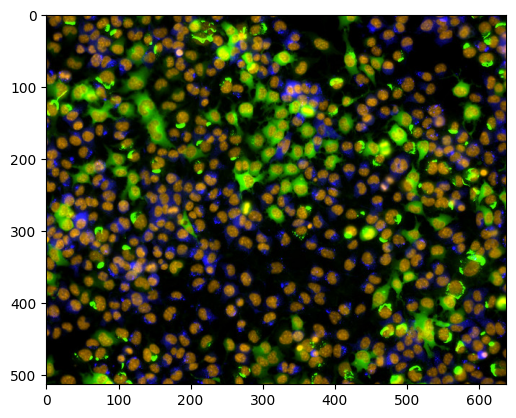

In [ ]:
plt.imshow(my_image)

[[0.45475729 0.55522752 0.05355373 ... 0.57990526 0.92852679 0.84211291]
 [0.87875168 0.40254383 0.61240876 ... 0.28670144 0.6900183  0.65425458]
 [0.56234895 0.03944442 0.73657243 ... 0.86787029 0.58072446 0.57958598]
 ...
 [0.37758266 0.78338991 0.86879752 ... 0.57088108 0.45626769 0.35117802]
 [0.81717572 0.90114279 0.27978949 ... 0.98194176 0.93261533 0.69476505]
 [0.98254185 0.40090641 0.55775347 ... 0.13801732 0.72973487 0.79326439]]
3.5817210652933085e-07 0.9999999407572817


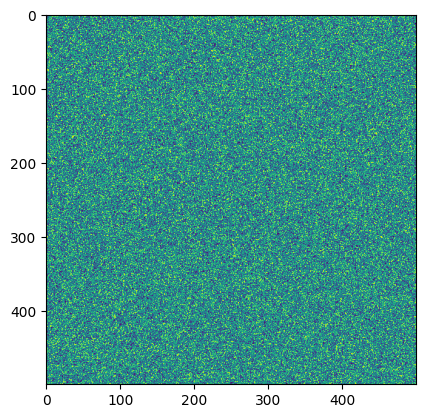

In [ ]:
random_image = np.random.random([500,500])
plt.imshow(random_image)
print(random_image)
print(random_image.min(), random_image.max())

0 255
0.0 1.0


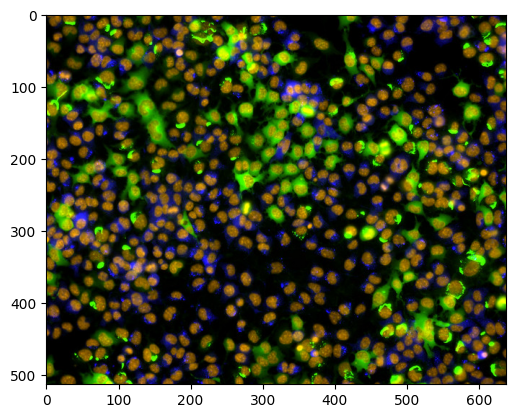

In [ ]:
my_float_image = img_as_float(my_image)
print(my_image.min(), my_image.max())
print(my_float_image.min(), my_float_image.max())

plt.imshow(my_image)
plt.imshow(my_float_image)

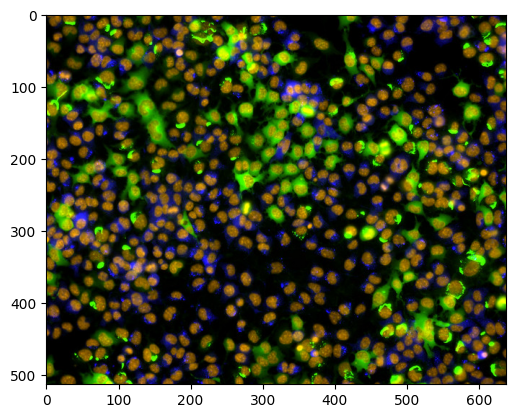

In [ ]:
plt.imshow(my_float_image)

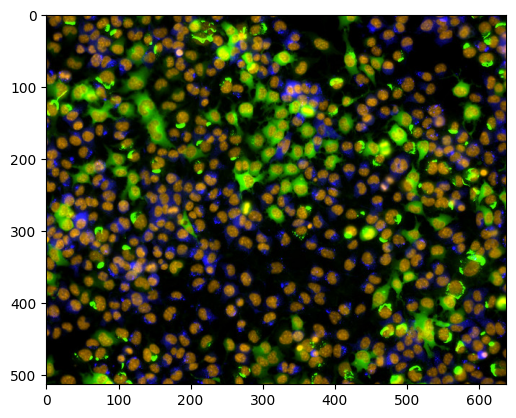

In [ ]:
plt.imshow(my_image)

0.0 127.5


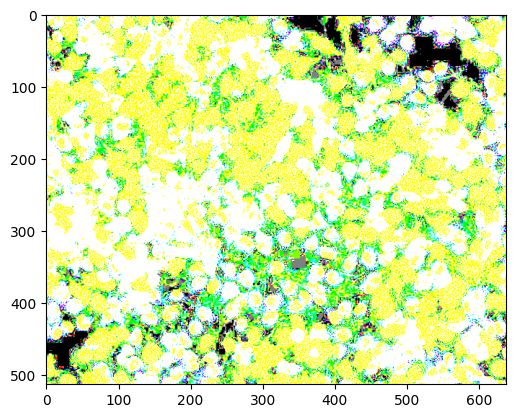

In [ ]:
dark_image = my_image*0.5
plt.imshow(dark_image)
print(dark_image.min(), dark_image.max())

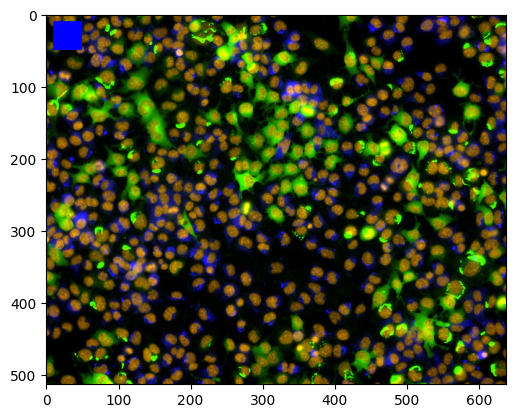

In [ ]:
my_image[10:50, 10:50, :] = [0,0,255]
plt.imshow(my_image)

### <a href ='https://www.youtube.com/watch?v=52pMFnkDU-4'>17 - Reading images in Python</a>

1.  Pillow
2.  Matplotlib
3.  skimage
4.  openCV
5.  czi, ome.tif
6.  glob for multi files
7.  skimage & apeer_ometiff_library both import io, Be care


In [ ]:
pip install czifile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install apeer-ometiff-Library first

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


<class 'PIL.JpegImagePlugin.JpegImageFile'>


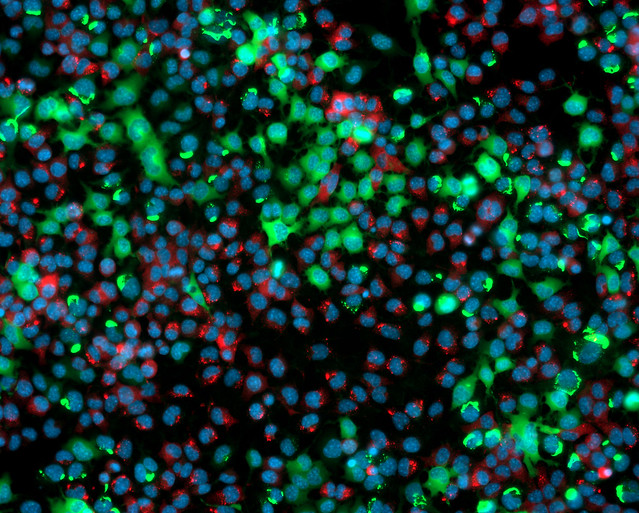

JPEG
<class 'numpy.ndarray'>


In [ ]:
# Pillow
img = Image.open('images/test_image.jpg')
print(type(img))

img.show()
print(img.format)

img1 = np.asarray(img)
print(type(img1))

<class 'numpy.ndarray'>
(513, 639, 3)


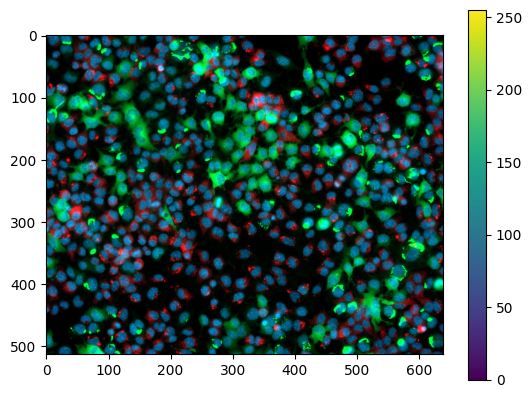

In [ ]:
# Matplotlib
# Pyplot

img = mpimg.imread('images/test_image.jpg')
print(type(img))
print(img.shape)
plt.imshow(img)
plt.colorbar()

<class 'numpy.ndarray'>


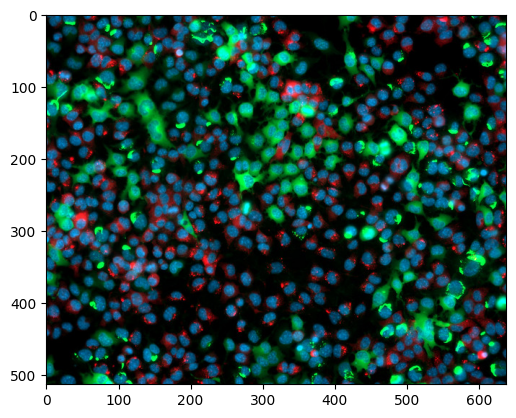

In [ ]:
# scikit-image
image = io.imread('images/test_image.jpg')
print(type(image))
plt.imshow(image)

In [ ]:
image_float = img_as_float(image)
print(image_float)
image_float = img_as_ubyte(image)
print(image_float)

[[[0.04705882 0.21176471 0.36078431]
  [0.         0.36470588 0.49411765]
  [0.         0.45882353 0.60392157]
  ...
  [0.         0.         0.        ]
  [0.         0.         0.        ]
  [0.         0.         0.        ]]

 [[0.06666667 0.23137255 0.3254902 ]
  [0.02745098 0.34901961 0.44313725]
  [0.         0.4        0.5372549 ]
  ...
  [0.         0.         0.        ]
  [0.         0.         0.        ]
  [0.         0.         0.        ]]

 [[0.09019608 0.16078431 0.20784314]
  [0.05490196 0.2627451  0.3254902 ]
  [0.01568627 0.30980392 0.42352941]
  ...
  [0.         0.         0.        ]
  [0.         0.         0.        ]
  [0.         0.         0.        ]]

 ...

 [[0.         0.10196078 0.01176471]
  [0.         0.09019608 0.00784314]
  [0.         0.08235294 0.01176471]
  ...
  [0.03137255 0.07843137 0.13333333]
  [0.01176471 0.03137255 0.05490196]
  [0.00392157 0.01176471 0.00784314]]

 [[0.         0.17647059 0.03137255]
  [0.         0.15294118 0.02745098]


In [ ]:
image = io.imread('images/test_image.jpg').astype(np.float)
print(image)

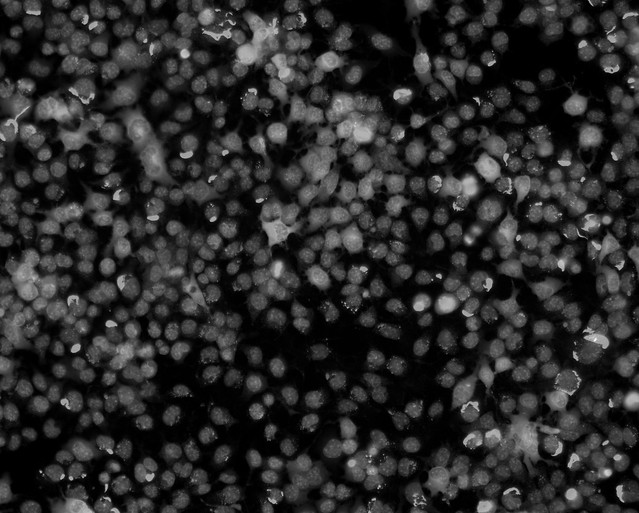

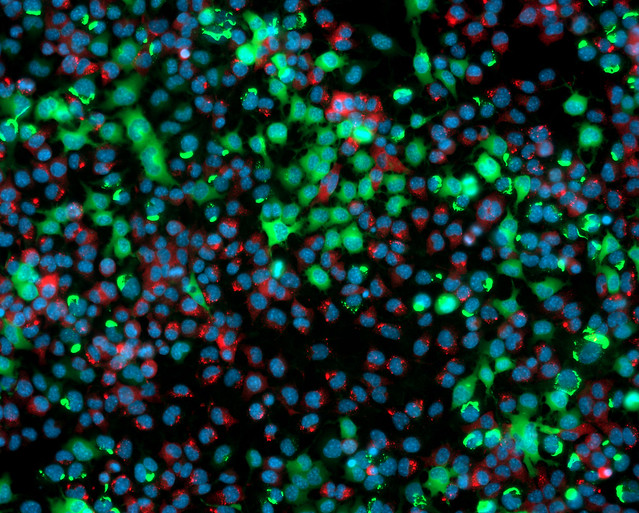

In [ ]:
# opencv-python

img = cv2.imread('images/test_image.jpg')
# plt.imshow(img)

img_grey = cv2.imread('images/test_image.jpg', 0)
cv2_imshow(img_grey)
cv2.waitKey(0)
cv2.destroyAllWindows

img_color = cv2.imread('images/test_image.jpg', 1)
cv2_imshow(img_color)


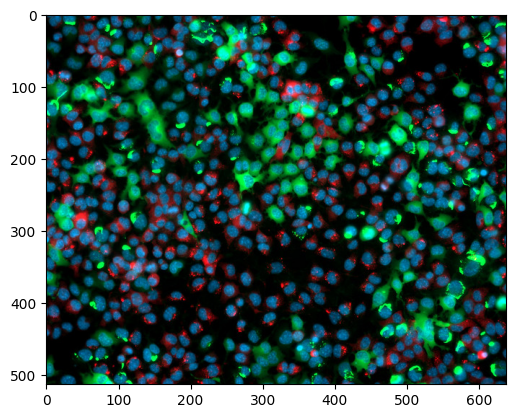

In [ ]:
plt.imshow(cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB))

In [ ]:
# czifile
img = czifile.imread('images/test_image.czi')
print(img.shape)

(1, 513, 639, 3)


In [ ]:
# OME-TIFF
(pic2, omexml) = io.read_ometiff('images/test_image.ome.tif')

print(pic2.shape)
print(omexml)

(1, 1, 3, 513, 639)
<?xml version="1.0" encoding="UTF-8" standalone="no"?><!-- Warning: this comment is an OME-XML metadata block, which contains crucial dimensional parameters and other important metadata. Please edit cautiously (if at all), and back up the original data before doing so. For more information, see the OME-TIFF web site: https://docs.openmicroscopy.org/latest/ome-model/ome-tiff/. --><OME xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" Creator="OME Bio-Formats 5.8.1" UUID="urn:uuid:338c3175-9da3-4ffd-9f8a-94f81e622c85" xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd"><Image ID="Image:0"><Pixels DimensionOrder="XYCZT" ID="Pixels:0" PhysicalSizeX="1.0" PhysicalSizeXUnit="µm" PhysicalSizeY="1.0" PhysicalSizeYUnit="µm" PhysicalSizeZ="1.0" PhysicalSizeZUnit="µm" SizeC="3" SizeT="1" SizeX="639" SizeY="513" SizeZ="1" TimeIncrement="0.0"

images/test_images/aeroplane/2.jpg


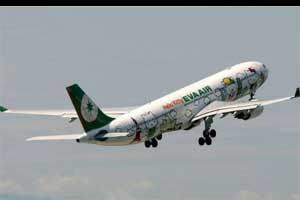

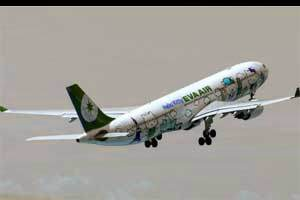

images/test_images/aeroplane/4.jpg


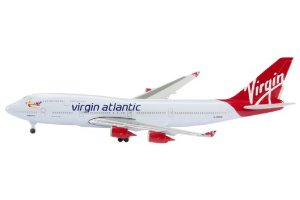

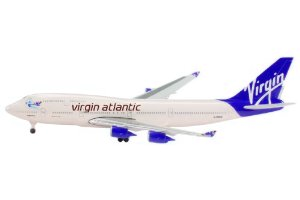

images/test_images/aeroplane/1.jpg


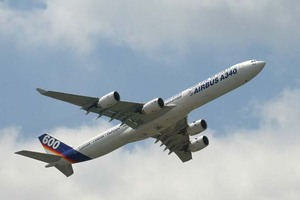

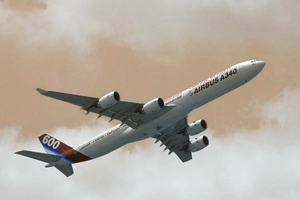

images/test_images/aeroplane/3.jpg


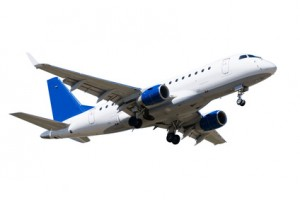

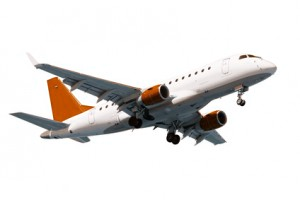

In [ ]:
# glob

path = 'images/test_images/aeroplane/*'

for file in glob.glob(path):
  print(file)
  a = cv2.imread(file)
  # print(a)

  c = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
  cv2_imshow(a)
  cv2_imshow(c)

## Libraries

### <a href='https://www.youtube.com/watch?v=uDNqNv2N-pY'>18 - Image processing using pillow in Python</a>

1.  basic type
2.  resize
3.  cropped
4.  copy & paste
5.  rotate
6.  flip
7.  glob

In [ ]:
img = Image.open('images/test_image.jpg')
print(type(img))
print(img.format)
print(img.mode)
print(img.size)

<class 'PIL.JpegImagePlugin.JpegImageFile'>
JPEG
RGB
(639, 513)


In [ ]:
# resize
small_img = img.resize((200,300))
small_img.save('images/test_image_small.jpg')

In [ ]:
img.thumbnail((200,300))
img.save('images/test_image_thumbnail.jpg')

In [ ]:
img.thumbnail((1200,1300))
img.save('images/test_image_thumbnail.jpg')
print(img.size)

(200, 161)


In [ ]:
# cropped
img = Image.open('images/test_image.jpg')
cropped_img = img.crop((0,0,300,300))
cropped_img.save('images/test_image_cropped.jpg')

In [ ]:
# copy & paste
img1 = Image.open('images/test_image.jpg')
print(img1.size)
img2 = Image.open('images/monkey.jpg')
print(img2.size)
img2.thumbnail((150,200))

img1_copy = img1.copy()
img1_copy.paste(img2, (50,50))
img1_copy.save('images/pasted_image.jpg')

(639, 513)
(220, 330)


In [ ]:
# rotate
img = Image.open('images/test_image.jpg')
img90 = img.rotate(90)
img90.save('images/rotated90_image.jpg')

img45 = img.rotate(45, expand=True)
img45.save('images/rotated45_image.jpg')

In [ ]:
# flip
img = Image.open('images/monkey.jpg')
img_flipLR = img.transpose(Image.FLIP_LEFT_RIGHT)
img_flipLR.save('images/flipLR.jpg')

img = Image.open('images/monkey.jpg')
img_flipTB = img.transpose(Image.FLIP_TOP_BOTTOM)
img_flipTB.save('images/flipTB.jpg')

In [ ]:
# greyscale
img = Image.open('images/monkey.jpg')
grey_img = img.convert('L')
grey_img.save('images/grey_monkey.jpg')

In [ ]:
# glob
import glob

path = 'images/test_images/aeroplane/*'
for file in glob.glob(path):
  # print(file)
  a = Image.open(file)
  rotated45 = a.rotate(45, expand=True)
  rotated45.save(file+'ratated45.png', 'PNG')

### <a href='https://www.youtube.com/watch?v=s_hDL2fGvow'>19 - image processing using scipy in Python</a>

1.  extraction
2.  flip,rotate
3.  filter
4.  sobel Edge detection

In [ ]:
# img = misc.imread('images/monkey.jpg')
img = io.imread('images/monkey.jpg', as_gray=True)
print(type(img))

<class 'numpy.ndarray'>


In [ ]:
print(type(img))
print(img.dtype, img.shape)

<class 'numpy.ndarray'>
float64 (330, 220)


In [ ]:
print(img[10:15, 20:25])

[[0.26999373 0.27643804 0.28428118 0.28736941 0.29157373]
 [0.27391529 0.28035961 0.28820275 0.29604588 0.29549529]
 [0.27783686 0.28428118 0.29604588 0.29996745 0.29352314]
 [0.27783686 0.28820275 0.29996745 0.30781059 0.29744471]
 [0.28175843 0.29212431 0.30388902 0.31173216 0.30136627]]


In [ ]:
img = img_as_ubyte(io.imread('images/monkey.jpg', as_gray=True))
print(img[10:15, 20:25])

[[69 70 72 73 74]
 [70 71 73 75 75]
 [71 72 75 76 75]
 [71 73 76 78 76]
 [72 74 77 79 77]]


In [ ]:
mean_grey = img.mean()
max_value = img.max()
min_vale = img.min()

print('Min, Max and Mean are:', min_vale, max_value, mean_grey)

Min, Max and Mean are: 3 255 133.44224517906335


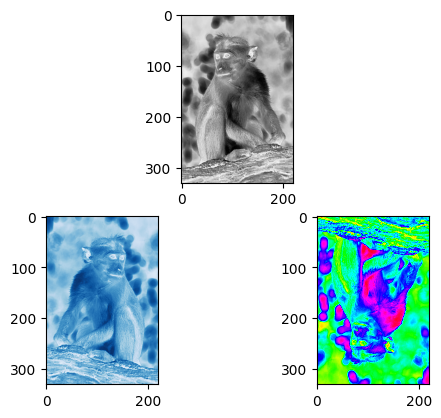

In [ ]:
flippedLR = np.fliplr(img)
flippedUD = np.flipud(img)

plt.subplot(2,1,1)
plt.imshow(img, cmap='Greys')
plt.subplot(2,2,3)
plt.imshow(flippedLR, cmap='Blues')
plt.subplot(2,2,4)
plt.imshow(flippedUD, cmap='hsv')

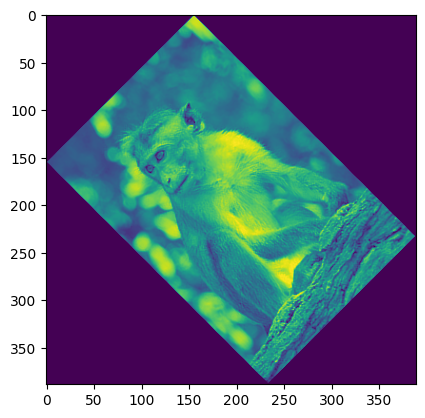

In [ ]:
img = img_as_ubyte(io.imread('images/monkey.jpg', as_gray=True))
rotated = ndimage.rotate(img, 45)
plt.imshow(rotated)

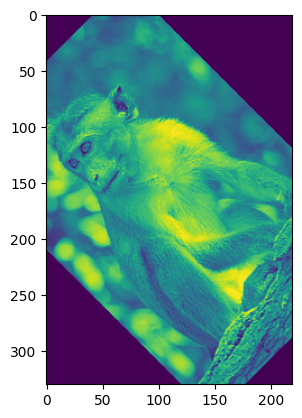

In [ ]:
rotated = ndimage.rotate(img, 45, reshape=False)
plt.imshow(rotated)

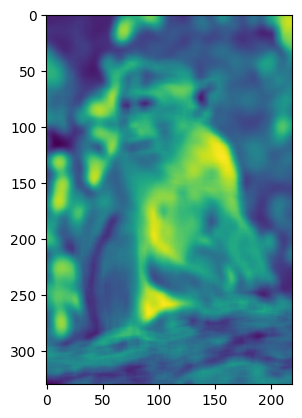

In [ ]:
uniform_filtered = ndimage.uniform_filter(img, size=9)
plt.imshow(uniform_filtered)

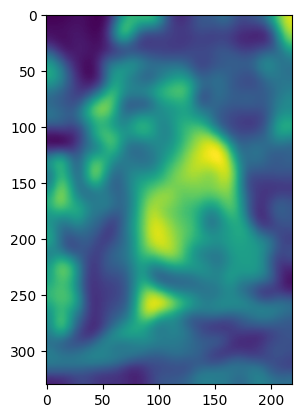

In [ ]:
gaussian_filtered = ndimage.gaussian_filter(img, sigma=7)
plt.imshow(gaussian_filtered)

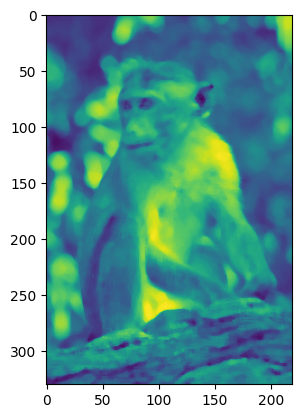

In [ ]:
median_filtered = ndimage.median_filter(img, 5)
plt.imshow(median_filtered)

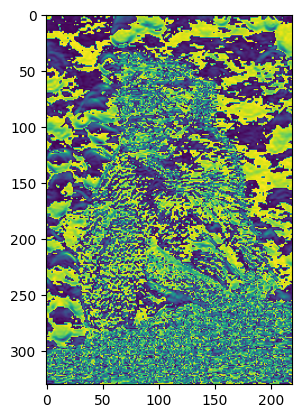

In [ ]:
sobel_img = ndimage.sobel(img, axis=0)
plt.imshow(sobel_img)

### <a href='https://www.youtube.com/watch?v=CTOURPZftuU'>20 - Introduction to image processing using scikit-image in Python</a>

1.  resize
2.  edge detection
3.  deconvolution
4.  entropy

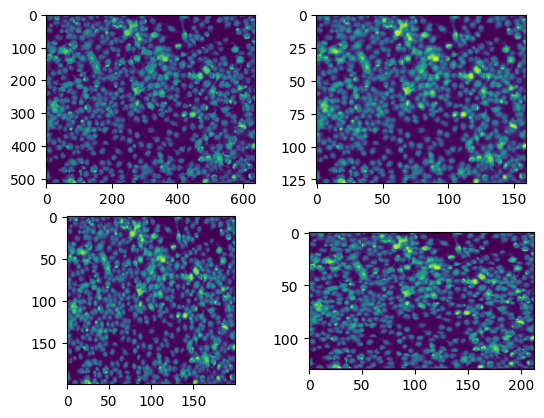

In [ ]:
img = io.imread('images/test_image.jpg', as_gray=True)
rescaled_img = rescale(img, 1.0/4.0, anti_aliasing=True)
resized_img = resize(img, (200,200))
downscaled_img = downscale_local_mean(img, (4,3))

plt.subplot(2,2,1)
plt.imshow(img)
plt.subplot(2,2,2)
plt.imshow(rescaled_img)
plt.subplot(2,2,3)
plt.imshow(resized_img)
plt.subplot(2,2,4)
plt.imshow(downscaled_img)

In [ ]:
img = io.imread('images/test_image_cropped.jpg', as_gray=True)
print(img.shape)

(300, 300)


<function matplotlib.pyplot.show(close=None, block=None)>

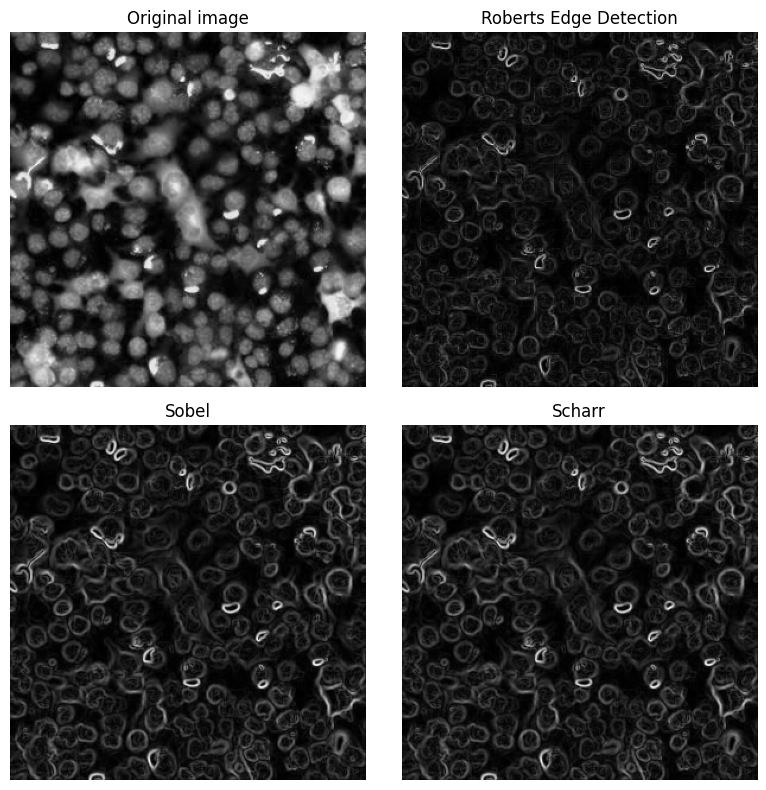

In [ ]:
edge_roberts = roberts(img)
edge_sobel = sobel(img)
edge_scharr = scharr(img)
edge_prewitt = prewitt(img)

# plt.imshow(edge_roberts, cmap='gray')

fig, axes = plt.subplots(nrows=2, ncols=2, sharex=True, sharey=True, figsize=(8,8))

ax = axes.ravel()

ax[0].imshow(img, cmap=plt.cm.gray)
ax[0].set_title('Original image')

ax[1].imshow(edge_roberts, cmap=plt.cm.gray)
ax[1].set_title('Roberts Edge Detection')

ax[2].imshow(edge_sobel, cmap=plt.cm.gray)
ax[2].set_title('Sobel')

ax[3].imshow(edge_scharr, cmap=plt.cm.gray)
ax[3].set_title('Scharr')

for a in ax:
  a.axis('off')

plt.tight_layout()
plt.show

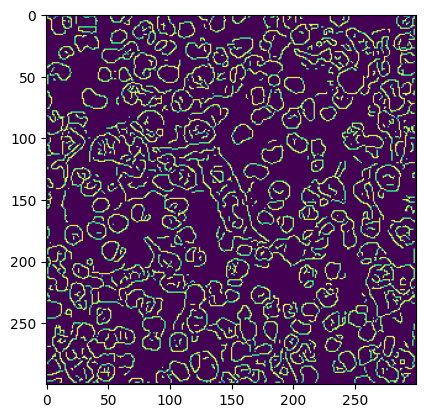

In [ ]:
edge_canny = canny(img, sigma=1)
plt.imshow(edge_canny)

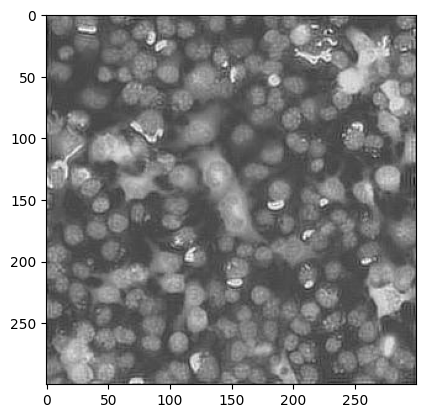

In [ ]:
psf = np.ones((3,3))/9

deconvolved, _ = restoration.unsupervised_wiener(img, psf)
plt.imsave('images/deconvolved.jpg', deconvolved, cmap='gray')

img2 = io.imread('images/deconvolved.jpg')
plt.imshow(img2)

[[0.00120229 0.00828598 0.01569749 0.00828598 0.00120229]
 [0.00828598 0.05710569 0.10818462 0.05710569 0.00828598]
 [0.01569749 0.10818462 0.20495178 0.10818462 0.01569749]
 [0.00828598 0.05710569 0.10818462 0.05710569 0.00828598]
 [0.00120229 0.00828598 0.01569749 0.00828598 0.00120229]]


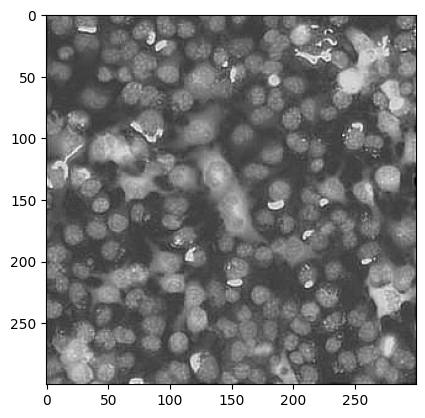

In [ ]:
def gkern(kernlen=21, nsig=2):
  lim = kernlen/2 + (kernlen % 2)/2
  x = np.linspace(-lim, lim, kernlen+1)
  kern1d = np.diff(st.norm.cdf(x))
  kern2d = np.outer(kern1d, kern1d)
  return kern2d/kern2d.sum()

psf = gkern(5,3)
print(psf)

deconvolved, _ = restoration.unsupervised_wiener(img, psf)
plt.imsave('images/deconvolved.jpg', deconvolved, cmap='gray')

img2 = io.imread('images/deconvolved.jpg')
plt.imshow(img2)

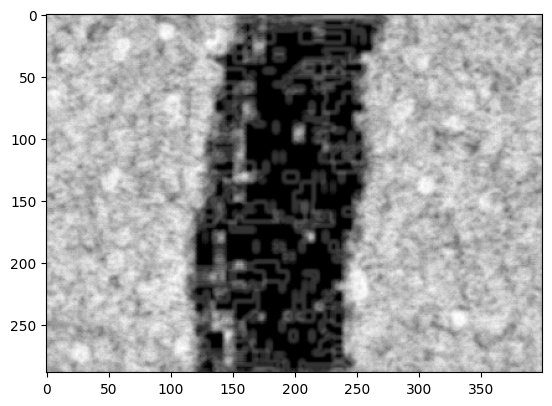

In [ ]:
img = io.imread('images/scratch.jpg')
entr_img = entropy(img, disk(3))
plt.imshow(entr_img, cmap='gray')

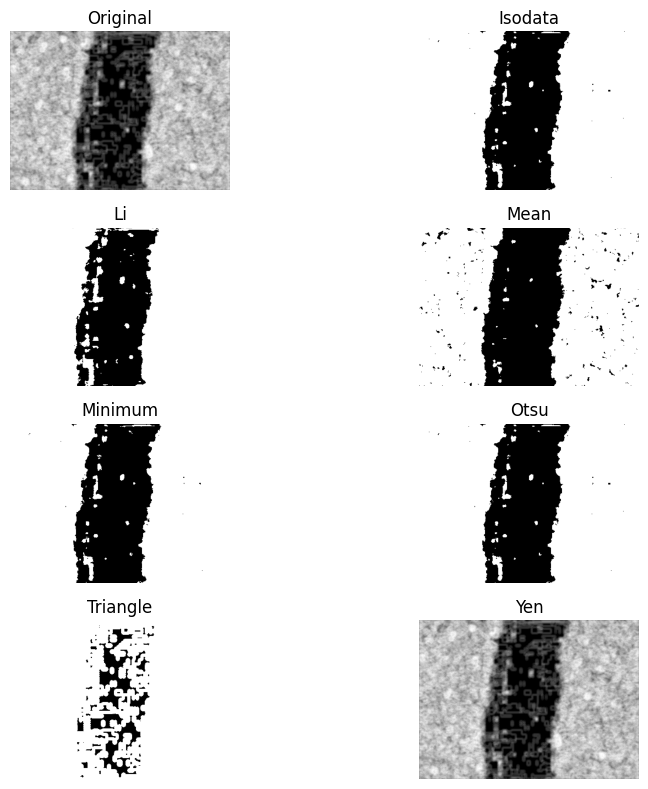

In [ ]:
fig, ax = try_all_threshold(entr_img, figsize=(10,8), verbose=False)
plt.imshow(entr_img, cmap='gray')

The percent bright pixels is: 28.91522491349481


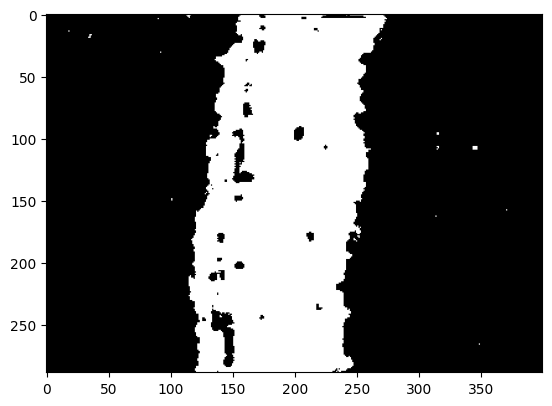

In [ ]:
thresh = threshold_otsu(entr_img)

binary = entr_img <= thresh
plt.imshow(binary, cmap='gray')
print('The percent bright pixels is:', (np.sum(binary==1)*100/((np.sum(binary==1)+(np.sum(binary==0))))))

### <a href='https://www.youtube.com/watch?v=jcUx-TQpcM8'>21 - Scratch assay analysis with just 5 lines code in Python</a>

1.  img seg
2.  for loop
3.  make fig

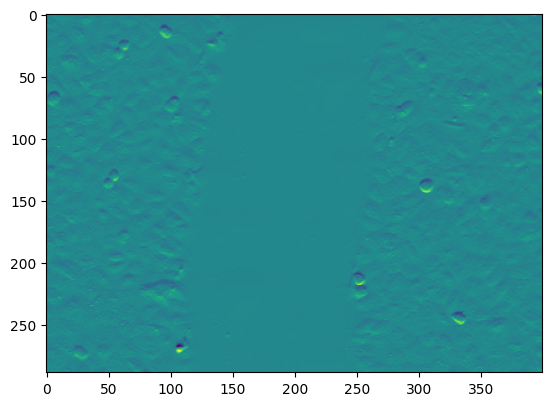

In [ ]:
img = io.imread('images/scratch.jpg')
plt.imshow(img)

34056


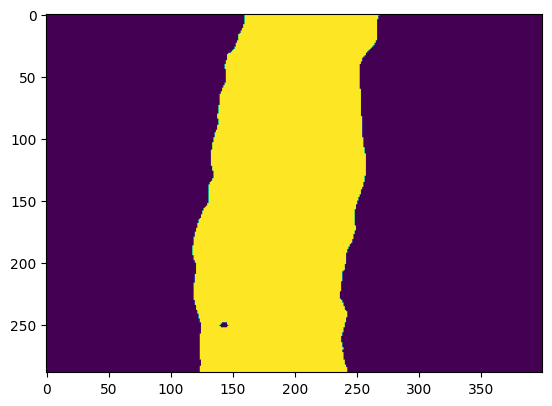

In [ ]:
entropy_img = entropy(img, disk(12))
thresh = threshold_otsu(entropy_img)
# print(thresh)
# plt.imshow(entropy_img)
binary = entropy_img <= thresh
plt.imshow(binary)
print(np.sum(binary == 1))

images/scratch_assay/Scratch0.jpg 0 34056
images/scratch_assay/Scratch1.jpg 1 28218
images/scratch_assay/Scratch2.jpg 2 23536
images/scratch_assay/Scratch3.jpg 3 20489
images/scratch_assay/Scratch4.jpg 4 18111
images/scratch_assay/Scratch5.jpg 5 15622
images/scratch_assay/Scratch6.jpg 6 14102
images/scratch_assay/Scratch7.jpg 7 12502
images/scratch_assay/Scratch8.jpg 8 10949
images/scratch_assay/Scratch9.jpg 9 8860
y =  -2572.527272727273 x + 30220.87272727273
R² =  0.9425785706337135


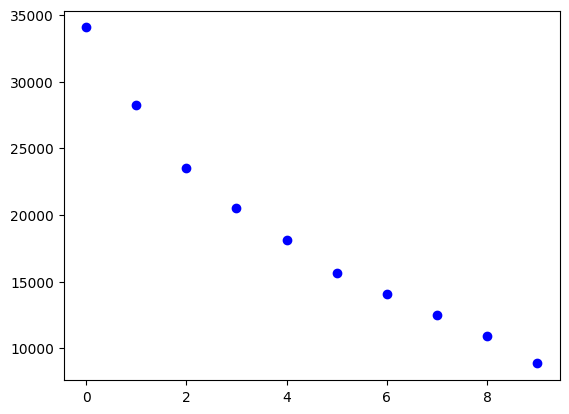

In [ ]:
time = 0
time_list = []
area_list = []
path = 'images/scratch_assay/*.*'

for file in sorted(glob.glob(path)):


  img = io.imread(file)
  entropy_img = entropy(img, disk(12))
  thresh = threshold_otsu(entropy_img)
  binary = entropy_img <= thresh
  scratch_area = np.sum(binary == True)
  print(file, time, scratch_area)
  time_list.append(time)
  area_list.append(scratch_area)
  time += 1

# print(time_list, area_list)
plt.plot(time_list, area_list, 'bo')


slope, intercept, rvalue, pvalue, stderr = linregress(time_list, area_list)
print('y = ', slope, 'x', '+', intercept)
print('R\N{SUPERSCRIPT TWO} = ', rvalue**2)

### <a href='https://www.youtube.com/watch?v=2PrzKWkqOtU'>22 - Denoising microscope images in Python</a>

1.  gaussing
2.  median
3.  non local mean

[[0.00026475 0.00140172 0.00381028 0.00531767 0.00381028 0.00140172
  0.00026475]
 [0.00140172 0.00742141 0.02017349 0.02815437 0.02017349 0.00742141
  0.00140172]
 [0.00381028 0.02017349 0.05483722 0.07653151 0.05483722 0.02017349
  0.00381028]
 [0.00531767 0.02815437 0.07653151 0.10680833 0.07653151 0.02815437
  0.00531767]
 [0.00381028 0.02017349 0.05483722 0.07653151 0.05483722 0.02017349
  0.00381028]
 [0.00140172 0.00742141 0.02017349 0.02815437 0.02017349 0.00742141
  0.00140172]
 [0.00026475 0.00140172 0.00381028 0.00531767 0.00381028 0.00140172
  0.00026475]]


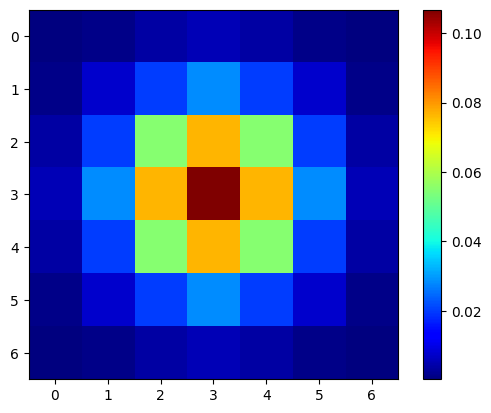

In [ ]:
def gaussian_kernel(size, size_y=None):
  size = int(size)
  if not size_y:
    size_y = size
  else:
    size_y = int(size_y)
  x, y =np.mgrid[-size:size+1, -size_y:size_y+1]
  g = np.exp(-(x**2/float(size)+y**2/float(size_y)))
  return g/g.sum()

gaussian_kernel_array = gaussian_kernel(3)
print(gaussian_kernel_array)
plt.imshow(gaussian_kernel_array, cmap=plt.get_cmap('jet'), interpolation='nearest')
plt.colorbar()
plt.show()

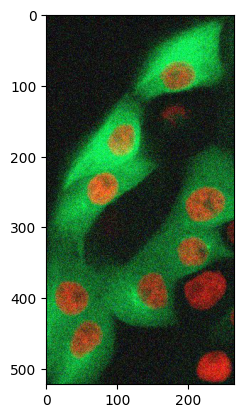

In [ ]:
img = io.imread('images/denoising/noisy_img.jpg')
plt.imshow(img)

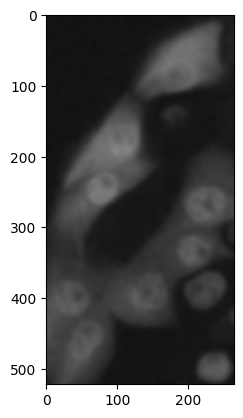

In [ ]:
gaussian_img = nd.gaussian_filter(img, sigma=3)
plt.imsave('images/denoising/gaussian.jpg', gaussian_img)
plt.imshow(gaussian_img)

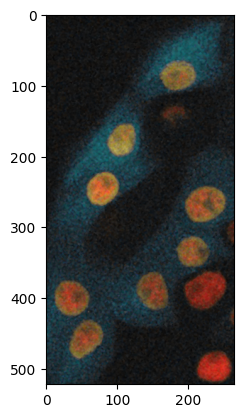

In [ ]:
median_img = nd.median_filter(img, size=3)
plt.imsave('images/denoising/median.jpg', median_img)
plt.imshow(median_img)

<ipython-input-75-267c6b42d1aa>:3: FutureWarning: `multichannel` is a deprecated argument name for `estimate_sigma`. It will be removed in version 1.0. Please use `channel_axis` instead.
  sigma_est = np.mean(estimate_sigma(img, multichannel=True))
<ipython-input-75-267c6b42d1aa>:4: FutureWarning: `multichannel` is a deprecated argument name for `denoise_nl_means`. It will be removed in version 1.0. Please use `channel_axis` instead.
  nlm_img = denoise_nl_means(img, h=1.15 * sigma_est, fast_mode=True, patch_size=5, patch_distance=3, multichannel=True)


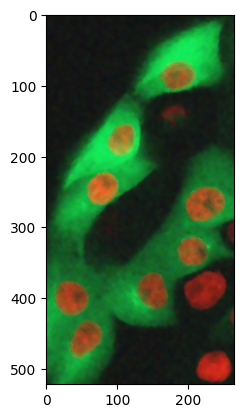

In [ ]:
img = img_as_float(io.imread('images/denoising/noisy_img.jpg'))
# read img as uint8 may be wrong， convert it as float is better
sigma_est = np.mean(estimate_sigma(img, multichannel=True))
nlm_img = denoise_nl_means(img, h=1.15 * sigma_est, fast_mode=True, patch_size=5, patch_distance=3, multichannel=True)
plt.imsave('images/denoising/nlm.jpg', nlm_img)
plt.imshow(nlm_img)

### <a href='https://www.youtube.com/watch?v=kIVk0IhDMwY'>23 - Histogram based image segmentation in Python</a>

1.  seg by hist
2.  flat and show
3.  color
4.  clean

<ipython-input-77-4c75b4298636>:3: FutureWarning: `multichannel` is a deprecated argument name for `estimate_sigma`. It will be removed in version 1.0. Please use `channel_axis` instead.
  sigma_est = np.mean(estimate_sigma(img, multichannel=False))
<ipython-input-77-4c75b4298636>:4: FutureWarning: `multichannel` is a deprecated argument name for `denoise_nl_means`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoise = denoise_nl_means(img, h=1.15*sigma_est, fast_mode=True, patch_size=5, patch_distance=3, multichannel=False)


(array([0.0000e+00, 0.0000e+00, 1.0000e+00, 6.0000e+00, 9.0000e+00,
        1.2100e+02, 4.9600e+02, 1.8720e+03, 1.4420e+03, 1.6740e+03,
        1.6270e+03, 1.7320e+03, 6.8140e+03, 1.1199e+04, 3.0491e+04,
        2.7028e+04, 3.6967e+04, 1.6567e+04, 1.4323e+04, 5.1460e+03,
        4.9270e+03, 4.6010e+03, 3.8410e+03, 8.4710e+03, 7.7810e+03,
        1.3974e+04, 9.7590e+03, 1.3793e+04, 8.2170e+03, 9.5450e+03,
        6.4040e+03, 2.7600e+03, 2.7180e+03, 1.2830e+03, 1.5420e+03,
        8.7600e+02, 1.2530e+03, 9.0800e+02, 1.6240e+03, 1.2350e+03,
        2.3560e+03, 2.9380e+03, 2.1150e+03, 3.0240e+03, 1.7490e+03,
        2.2100e+03, 1.2600e+03, 1.7890e+03, 1.2740e+03, 2.0550e+03,
        2.2850e+03, 1.6680e+03, 2.9090e+03, 2.4750e+03, 5.4560e+03,
        6.3700e+03, 1.8138e+04, 2.1101e+04, 4.7101e+04, 3.9380e+04,
        6.1025e+04, 5.0356e+04, 2.3132e+04, 2.0545e+04, 7.5710e+03,
        5.7210e+03, 2.0930e+03, 1.9100e+03, 7.8500e+02, 8.5900e+02,
        6.2400e+02, 3.0500e+02, 3.4200e+02, 1.78

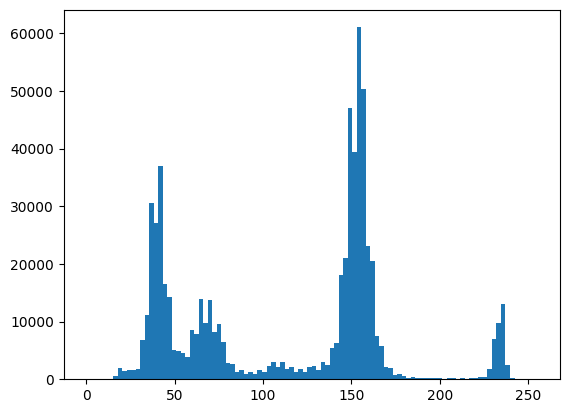

In [ ]:
img = img_as_float(io.imread('images/BSE_Google_noisy.jpg'))

sigma_est = np.mean(estimate_sigma(img, multichannel=False))
denoise = denoise_nl_means(img, h=1.15*sigma_est, fast_mode=True, patch_size=5, patch_distance=3, multichannel=False)

denoise_ubyte = img_as_ubyte(denoise)
# plt.imshow(denoise, cmap='gray')
plt.hist(denoise_ubyte.flat, bins=100, range=(0,255))

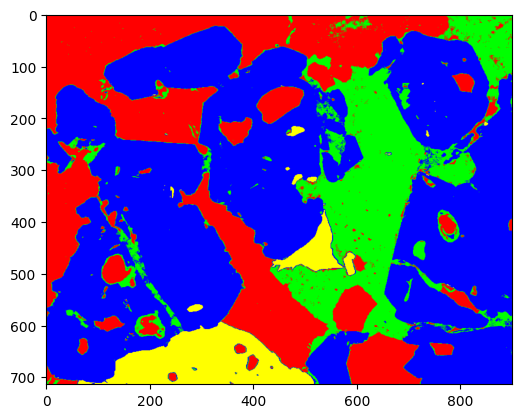

In [ ]:
segm1 = (denoise_ubyte <= 55)
segm2 = (denoise_ubyte > 55) & (denoise_ubyte <= 110)
segm3 = (denoise_ubyte > 110) & (denoise_ubyte <= 210)
segm4 = (denoise_ubyte > 210)

all_segments = np.zeros((denoise_ubyte.shape[0], denoise_ubyte.shape[1], 3))

all_segments[segm1] = (1,0,0)
all_segments[segm2] = (0,1,0)
all_segments[segm3] = (0,0,1)
all_segments[segm4] = (1,1,0)
plt.imshow(all_segments)

In [ ]:
seglist = [segm1, segm2, segm3, segm4]
for i in seglist:
  seg_opened = nd.binary_opening(i, np.ones((3,3)))
  closed_name = f'{i}_closed'
  closed_name = nd.binary_closing(seg_opened, np.ones((3,3)))

all_segments_cleaned = np.zeros((denoise_ubyte.shape[0], denoise_ubyte.shape[1], 3))

all_segments_cleaned[segm1_closed] = (1,0,0)
all_segments_cleaned[segm2_closed] = (0,1,0)
all_segments_cleaned[segm3_closed] = (0,0,1)
all_segments_cleaned[segm4_closed] = (1,1,0)

plt.imshow(all_segments_cleaned)

NameError: ignored

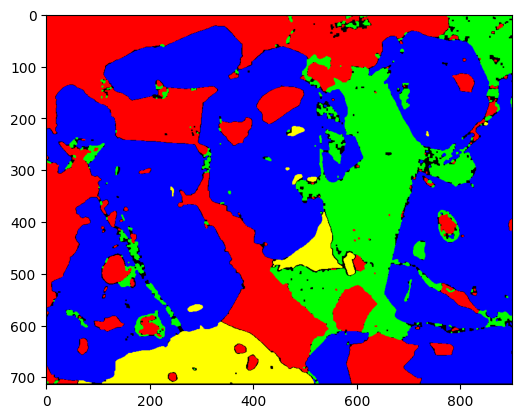

In [ ]:
# fix by chatGBT

seglist = [segm1, segm2, segm3, segm4]

# create empty arrays to store the closed segments
seg_closed_list = []

# apply binary opening and closing to each segment in the list
for i in seglist:
  seg_opened = nd.binary_opening(i, np.ones((3,3)))
  seg_closed = nd.binary_closing(seg_opened, np.ones((3,3)))
  seg_closed_list.append(seg_closed)

# create an array to store the cleaned segments
all_segments_cleaned = np.zeros((denoise_ubyte.shape[0], denoise_ubyte.shape[1], 3))

# assign colors to each segment and add it to the cleaned segments array
all_segments_cleaned[seg_closed_list[0]] = (1,0,0) # red
all_segments_cleaned[seg_closed_list[1]] = (0,1,0) # green
all_segments_cleaned[seg_closed_list[2]] = (0,0,1) # blue
all_segments_cleaned[seg_closed_list[3]] = (1,1,0) # yellow

# display the cleaned segments
plt.imshow(all_segments_cleaned)
plt.imsave('images/segmented.jpg', all_segments_cleaned)

### <a href='https://www.youtube.com/watch?v=6P8YhJa2V6o'>24 - Random Walker segmentation in Python</a>

1.  float 
2.  denoise
3.  hist_equalize
4.  markers 指派索引標記 (創建空矩陣，填入已確定)
5.  random walker 隨機分派未索引標記 (分配未確定)
6.  創建空矩陣, 再次填入索引標記



(array([0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00,
        0.0000e+00, 1.0000e+00, 2.0000e+00, 2.0000e+00, 3.0000e+00,
        1.1000e+01, 1.0000e+01, 1.4000e+01, 1.3000e+01, 2.4000e+01,
        3.0000e+01, 3.7000e+01, 5.8000e+01, 6.1000e+01, 1.2800e+02,
        1.6800e+02, 1.7200e+02, 2.7000e+02, 2.5100e+02, 5.1000e+02,
        4.0800e+02, 6.5500e+02, 6.0300e+02, 1.0460e+03, 8.5500e+02,
        1.4790e+03, 1.7840e+03, 1.3940e+03, 2.5320e+03, 2.0030e+03,
        3.4760e+03, 2.6180e+03, 4.4520e+03, 3.3800e+03, 5.5410e+03,
        6.1280e+03, 4.5680e+03, 7.4770e+03, 5.46

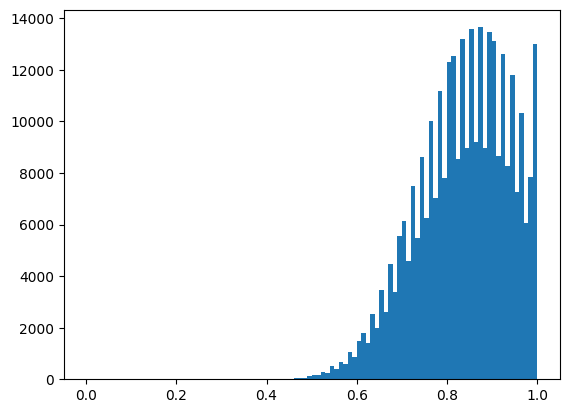

In [ ]:
img = img_as_float(io.imread('images/Alloy_noisy.jpg'))

plt.hist(img.flat, bins=100, range=(0,1))

<ipython-input-83-552d9f92c392>:7: FutureWarning: `multichannel` is a deprecated argument name for `denoise_nl_means`. It will be removed in version 1.0. Please use `channel_axis` instead.
  denoise_img = denoise_nl_means(img, h=1.15 * sigma_est, fast_mode=True, **patch_kw, multichannel=False)


(array([0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00, 1.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00,
        0.0000e+00, 1.0000e+00, 6.0000e+00, 4.80

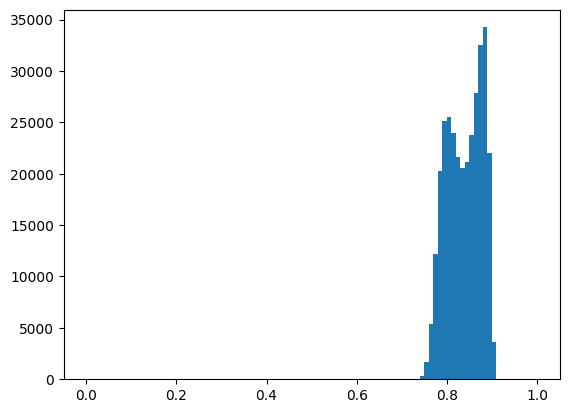

In [ ]:
sigma_est = np.mean(estimate_sigma(img, channel_axis=-1))

patch_kw = dict(patch_size=5,      # 5x5 patches
          patch_distance=6,  # 13x13 search area
          channel_axis=-1)

denoise_img = denoise_nl_means(img, h=1.15 * sigma_est, fast_mode=True, **patch_kw, multichannel=False)
# plt.imshow(denoise_img)

plt.hist(denoise_img.flat, bins=100, range=(0,1))

(array([2.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        2.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 2.000e+00, 1.000e+00, 0.000e+00, 1.000e+00,
        2.200e+01, 7.800e+01, 1.800e+02, 4.100e+02, 6.630e+02, 9.740e+02,
        1.306e+03, 1.602e+03, 2.041e+03, 2.330e+03, 2.537e+03, 2.870e+03,
        3.098e+03, 3.433e+03, 3.816e+03, 3.987e+03, 4.143e+03, 4.544e+03,
        4.571e+03, 4.761e+03, 4.938e+03, 4.941e+03, 5.111e+03, 4.972e+03,
        5.207e+03, 4.998e+03, 5.032e+03, 4.926e+03, 5.021e+03, 4.945e+03,
        4.897e+03, 4.697e+03, 4.554e+03, 4.539e+03, 4.463e+03, 4.327e+03,
        4.228e+03, 4.120e+03, 4.131e+03, 4.154e+03, 4.106e+03, 3.987e+03,
        4.122e+03, 4.097e+03, 3.977e+03, 4.085e+03, 4.024e+03, 4.065e+03,
        4.097e+03, 4.226e+03, 4.341e+03, 4.517e+03, 4.841e+03, 4.893e+03,
        5.044e+03, 5.200e+03, 5.570e+0

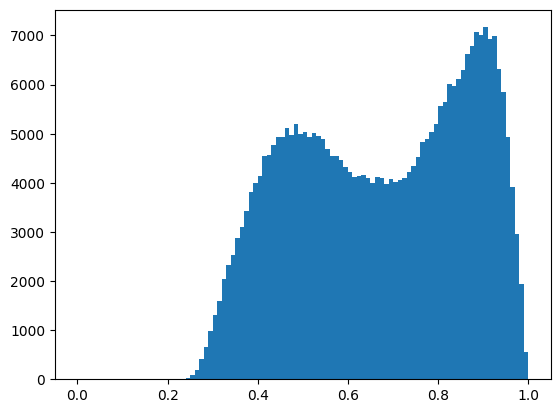

In [ ]:
eq_img = exposure.equalize_adapthist(denoise_img)

plt.hist(eq_img.flat, bins=100, range=(0,1))

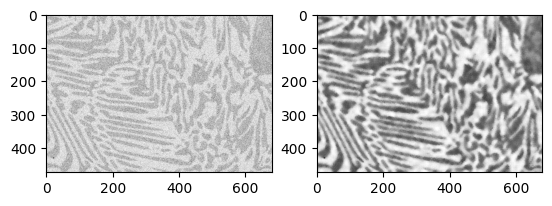

In [ ]:
plt.subplot(1,2,1)
plt.imshow(img, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(eq_img, cmap='gray')

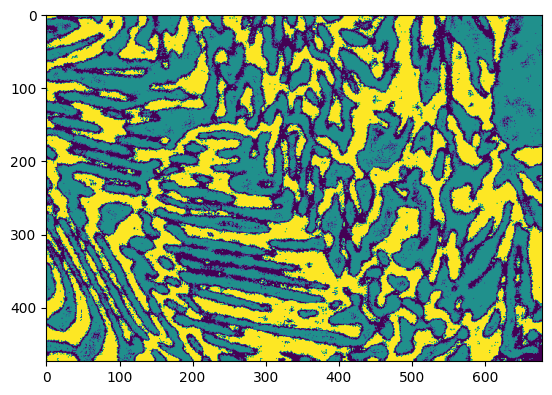

In [ ]:
markers = np.zeros(img.shape, dtype=np.uint)
markers[(eq_img > 0.3) & (eq_img < 0.6)] = 1
markers[(eq_img > 0.8) & (eq_img < 0.99)] = 2
plt.imshow(markers)

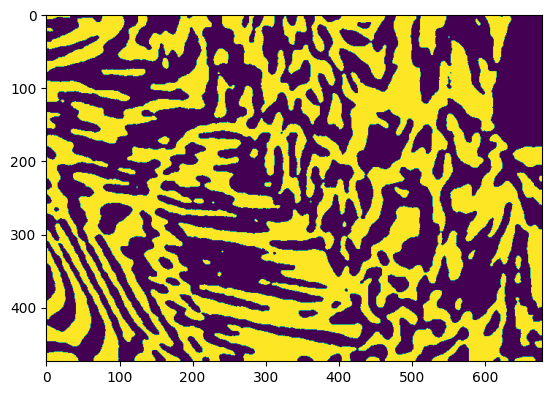

In [ ]:
labels = random_walker(eq_img, markers, beta=10, mode='bf')

plt.imshow(labels)

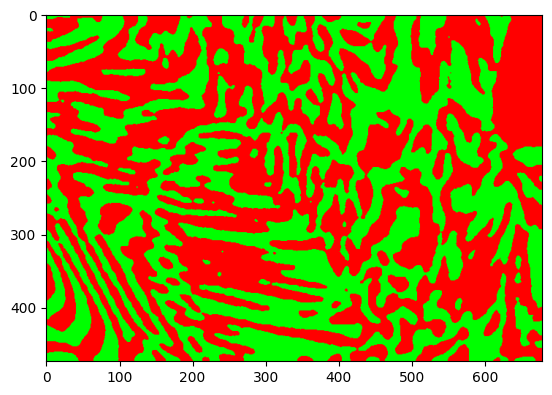

In [ ]:
segm1 = (labels == 1)
segm2 = (labels == 2)

all_segments = np.zeros((eq_img.shape[0], eq_img.shape[1], 3))
all_segments[segm1] = (1,0,0)
all_segments[segm2] = (0,1,0)

plt.imshow(all_segments)

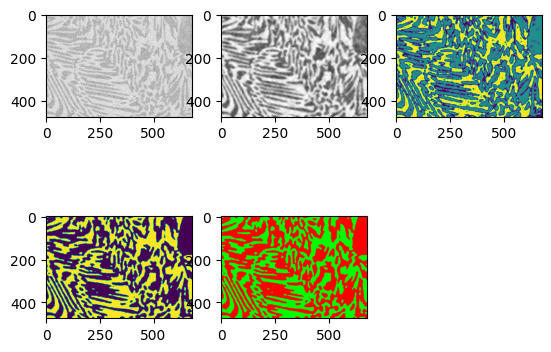

In [ ]:
plt.subplot(2,3,1)
plt.imshow(img, cmap='gray')
plt.subplot(2,3,2)
plt.imshow(eq_img, cmap='gray')
plt.subplot(2,3,3)
plt.imshow(markers)
plt.subplot(2,3,4)
plt.imshow(labels)
plt.subplot(2,3,5)
plt.imshow(all_segments)

## OpenCV

25-29

### <a href='https://www.youtube.com/watch?v=yj40XoUqo70'>25 - Reading Images, Splitting Channels, Resizing using openCV in Python</a>

1.  Reading Images
2.  Splitting, Merging Channels
3.  Resizing

In [ ]:
img = cv2.imread('images/RGBY.jpg')
print(img.shape)
img = cv2.imread('images/RGBY.jpg', 0)
print(img.shape)
img = cv2.imread('images/RGBY.jpg', 1)
print(img.shape)
img = cv2.imread('images/RGBY.jpg', 2)
print(img.shape)

(586, 415, 3)
(586, 415)
(586, 415, 3)
(586, 415)


In [ ]:
# openCV BGR
img = cv2.imread('images/RGBY.jpg')
print('Tope Left', img[0,0])
print('Tope Right', img[0,400])
print('Bottom Left', img[580,0])
print('Bottom Right', img[580,400])

Tope Left [38  3  0]
Tope Right [ 0 20 21]
Bottom Left [ 0 55  0]
Bottom Right [ 16   6 250]


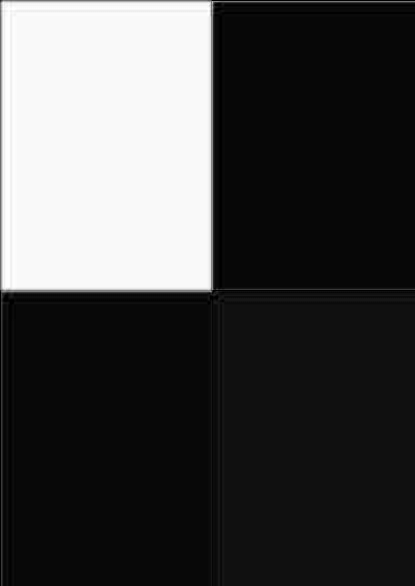

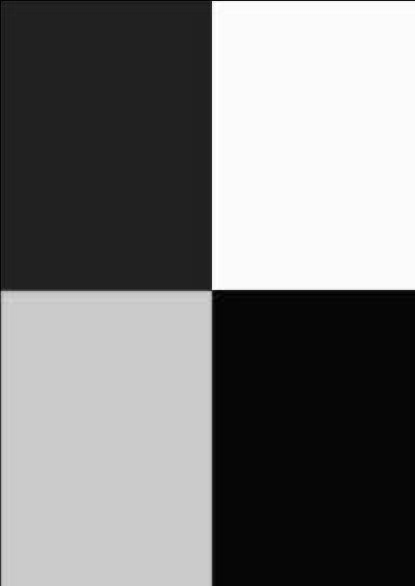

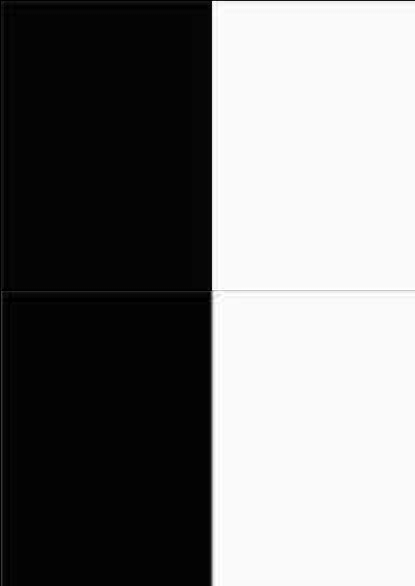

In [ ]:
blue = img[:, :, 0]
green =img[:, :, 1]
red = img[:, :, 2]

cv2_imshow(blue)
cv2_imshow(green)
cv2_imshow(red)

# cv2.imshow
# cv2.waitKey(0)
# cv2.destroyAllWindows()

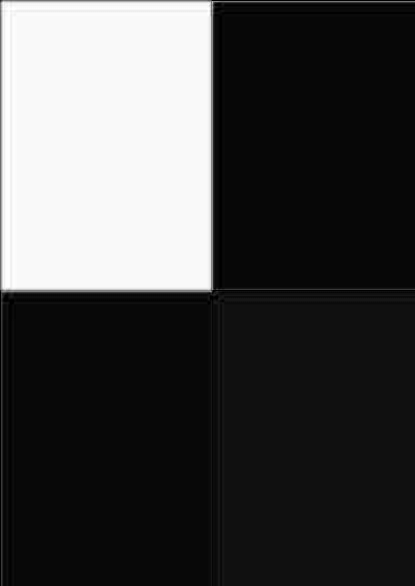

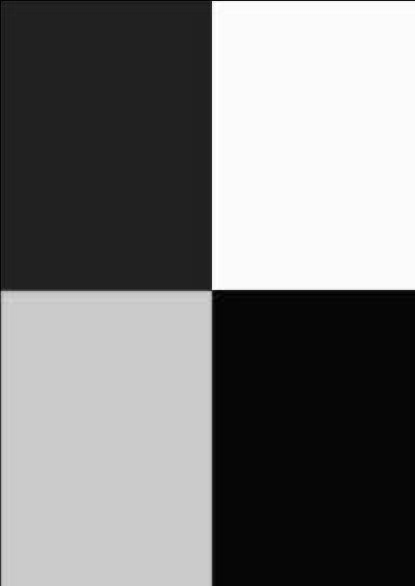

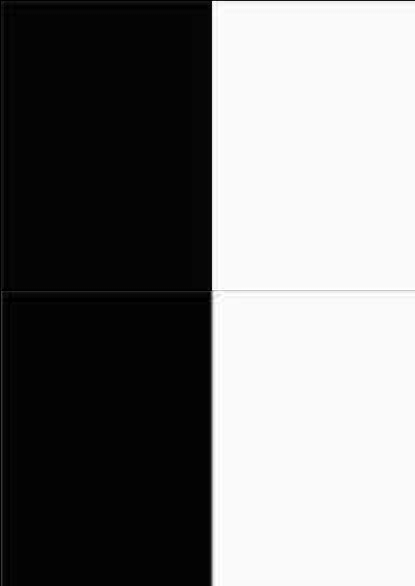

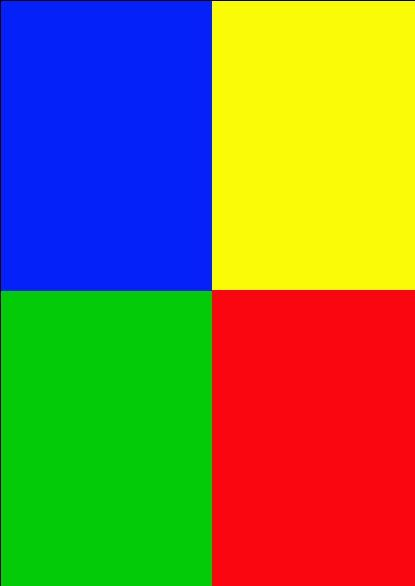

In [ ]:
b, g, r = cv2.split(img)

img_merged = cv2.merge((b, g, r))

cv2_imshow(b)
cv2_imshow(g)
cv2_imshow(r)

cv2_imshow(img_merged)

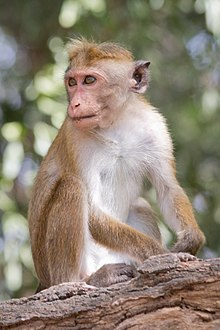

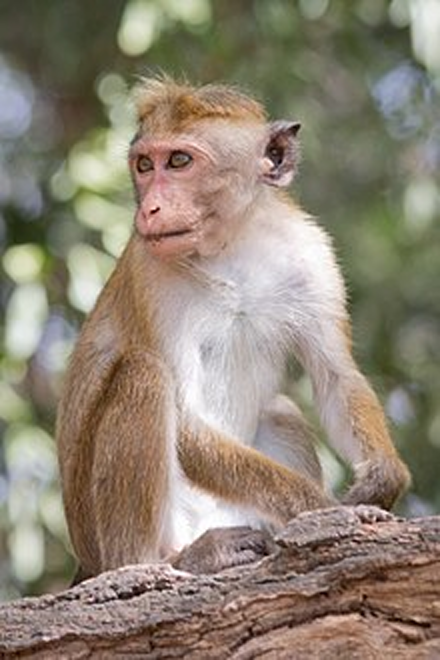

In [ ]:
img = cv2.imread('images/monkey.jpg')
cv2_imshow(img)

resized = cv2.resize(img, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC)

cv2_imshow(resized)

### <a href='https://www.youtube.com/watch?v=-Qnb8Wv2p1c'>26 - Denoising and edge detection using opencv in Python</a>

1.  Denoising: filter2D, blur, gussain, median, bilateral
2.  Edge detect: Canny

In [ ]:
img = cv2.imread('images/BSE_Google_noisy.jpg', 1)
x, y = 3, 3
kernel = np.ones((x,y), np.float32)/(x*y)

filt_2D = cv2.filter2D(img, -1, kernel)

cv2_imshow(img)
cv2_imshow(filt_2D)

Output hidden; open in https://colab.research.google.com to view.

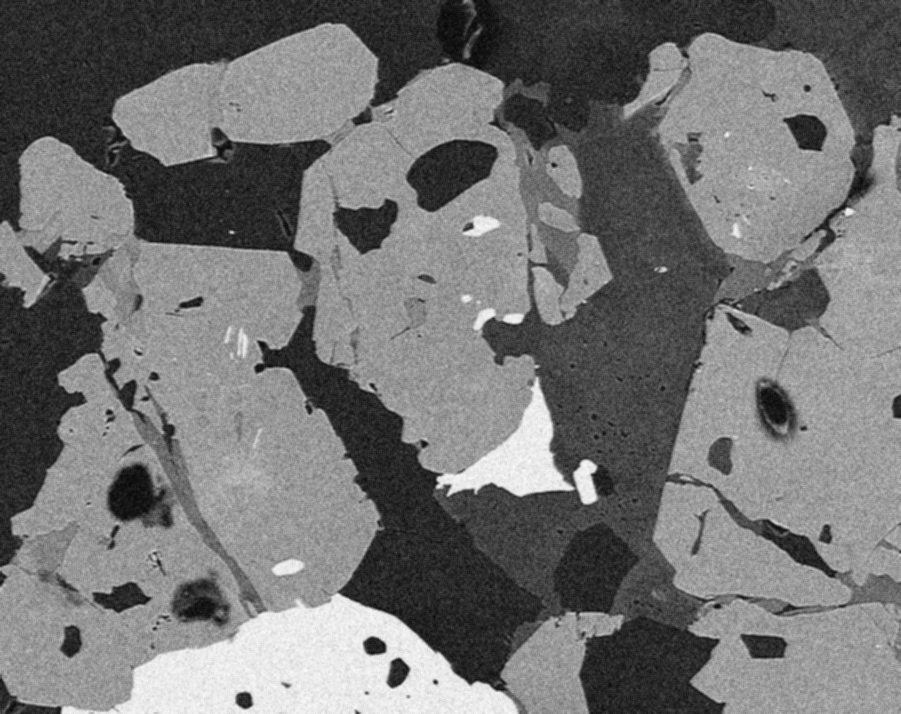

In [ ]:
# blur = filter2D + (kernel=ones)
blur = cv2.blur(img, (x,y))
cv2_imshow(blur)

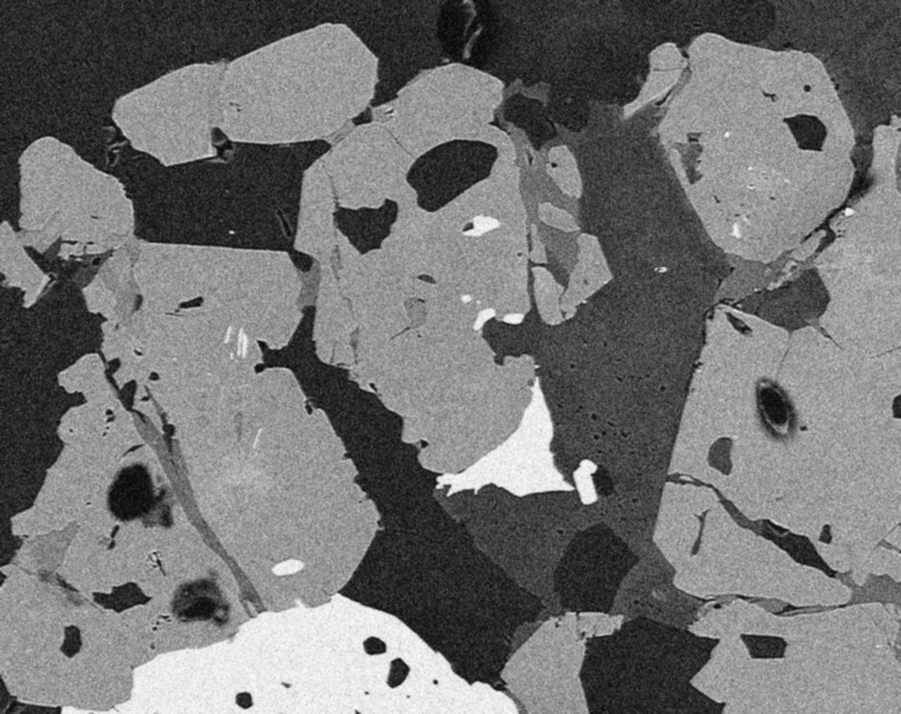

In [ ]:
gaussin_blur = cv2.GaussianBlur(img, (x,y), 0)
cv2_imshow(gaussin_blur)

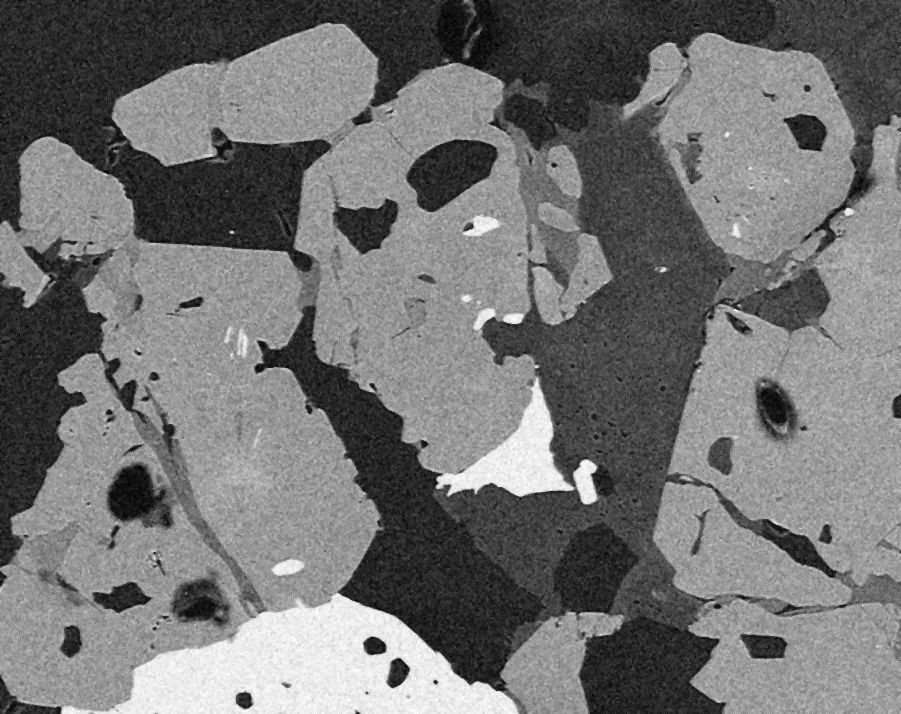

In [ ]:
median_blur = cv2.medianBlur(img, x)
cv2_imshow(median_blur)

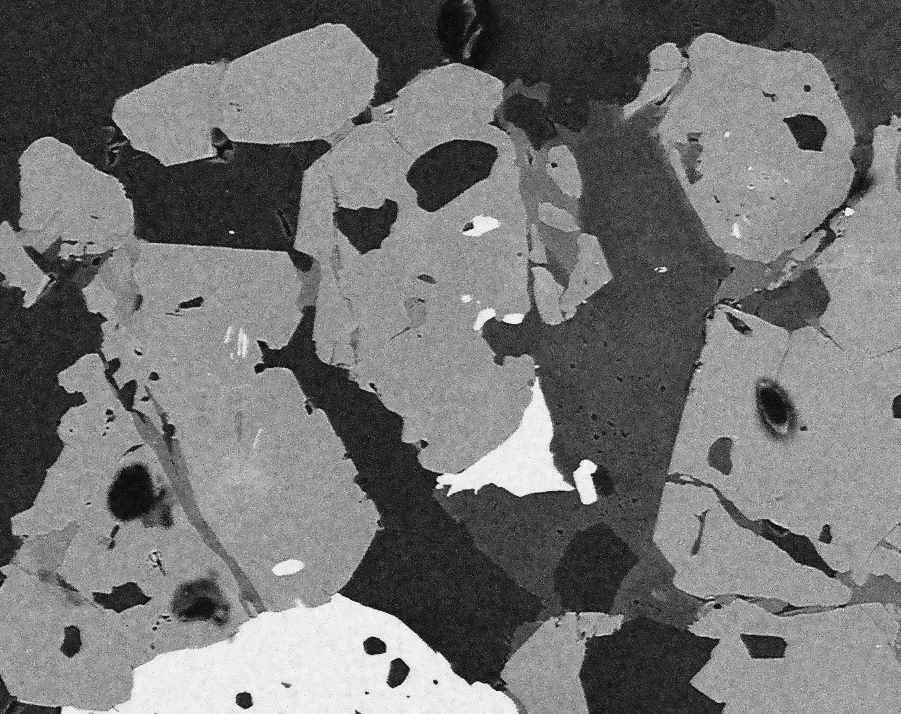

In [ ]:
bilateral_blur = cv2.bilateralFilter(img, 9, 75, 75)
cv2_imshow(bilateral_blur)

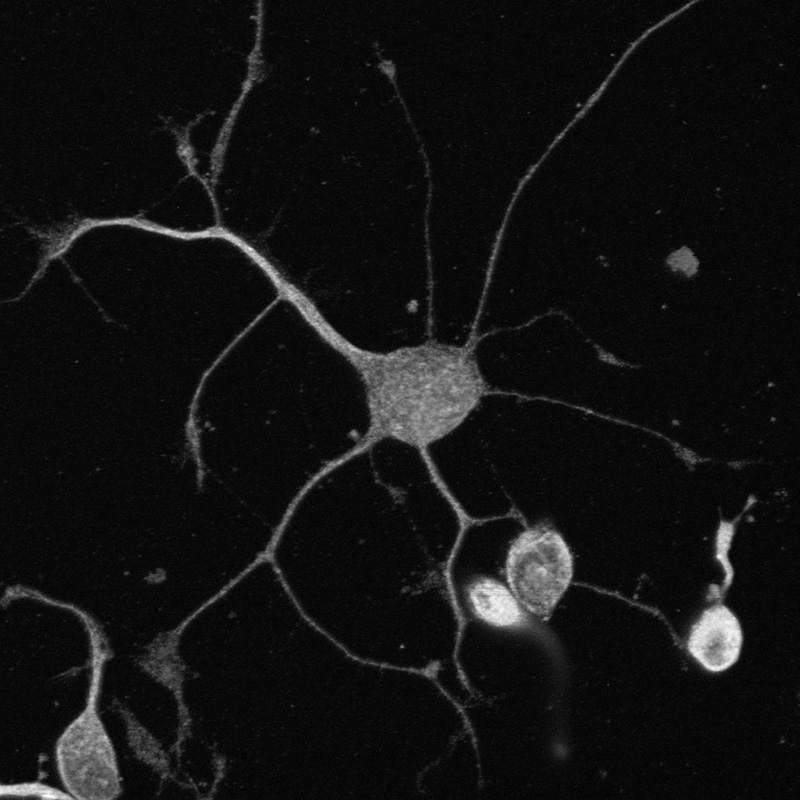

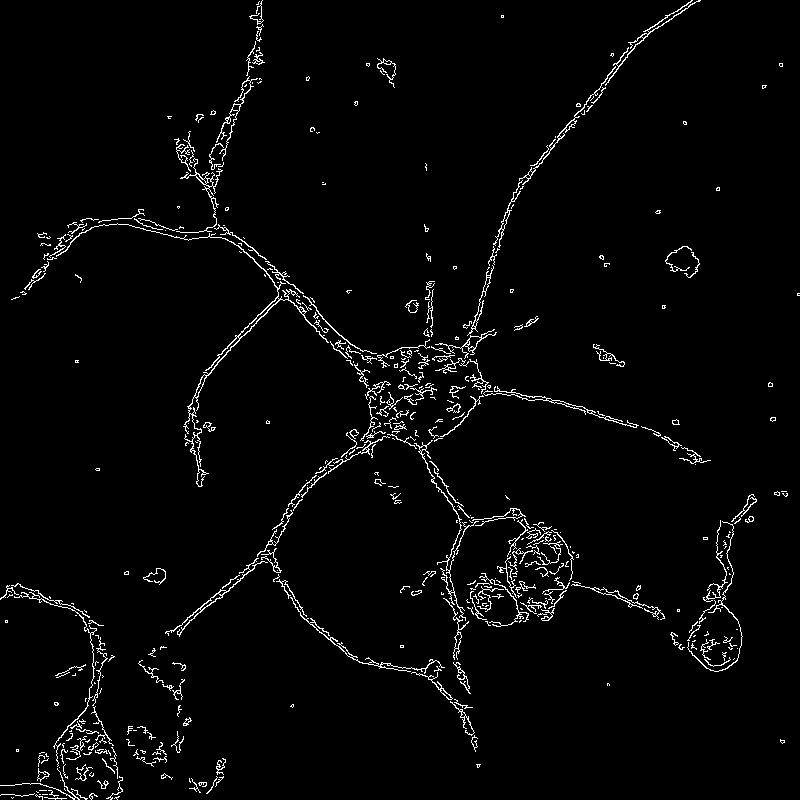

In [ ]:
img = cv2.imread('images/Neuron.jpg', 0)
edge = cv2.Canny(img, 100, 200)

cv2_imshow(img)
cv2_imshow(edge)

### <a href='https://www.youtube.com/watch?v=XfDkg3z3BCg'>27 - CLAHE and Thresholding using opencv in Python</a>

1.  Threshold
2.  OTSU

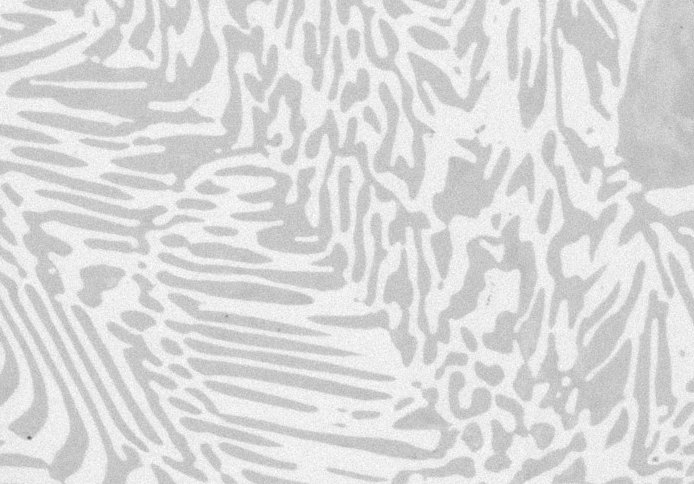

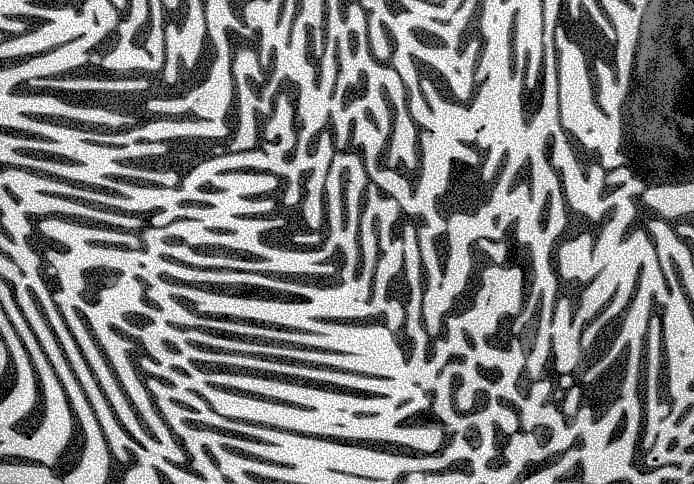

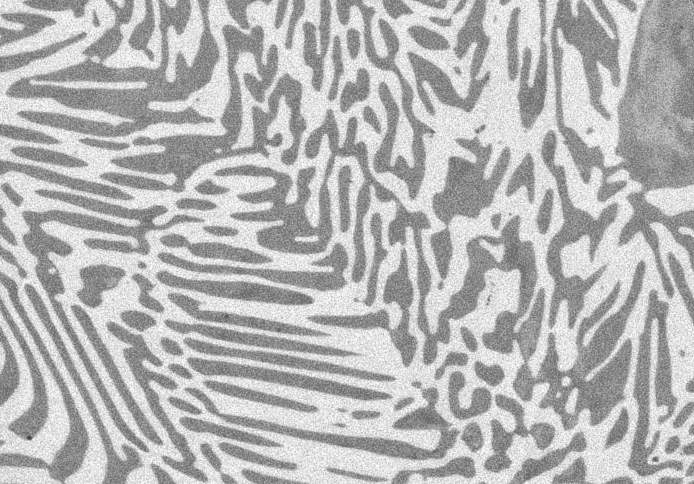

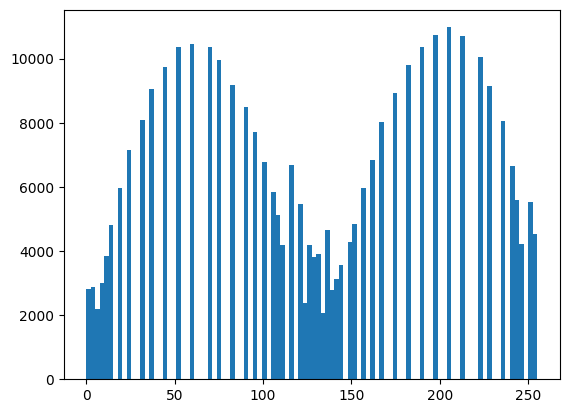

In [ ]:
img = cv2.imread('images/Alloy.jpg', 0)
eq_img = cv2.equalizeHist(img)

plt.hist(eq_img.flat, bins=100, range=(0,255))

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
cl_img = clahe.apply(img)

cv2_imshow(img)
cv2_imshow(eq_img)
cv2_imshow(cl_img)

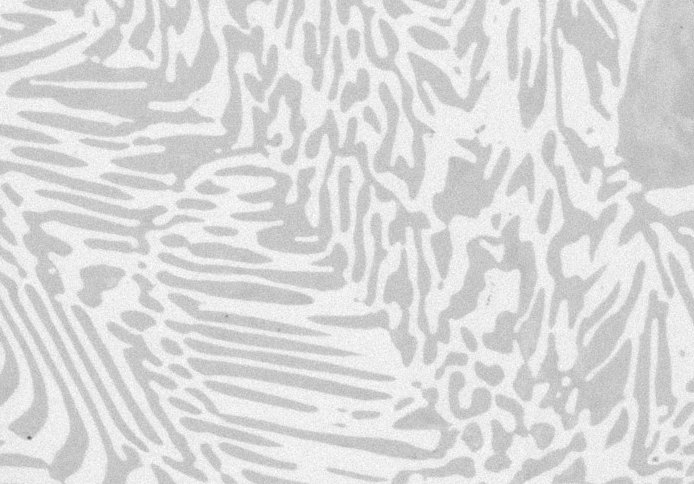

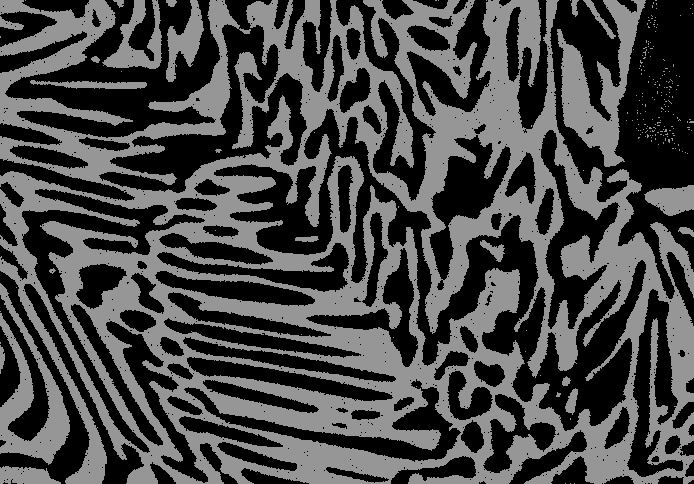

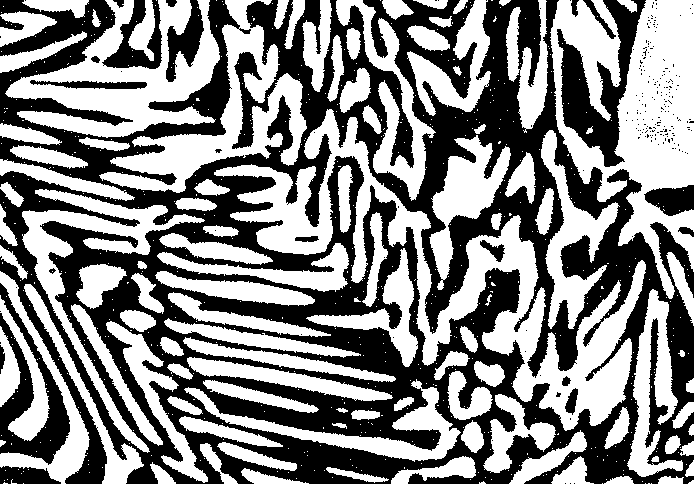

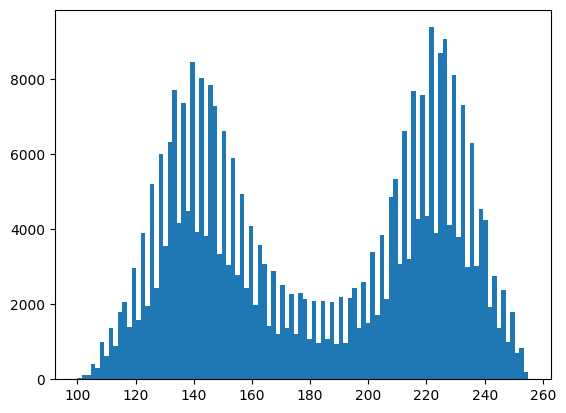

In [ ]:
plt.hist(cl_img.flat, bins=100, range=(100,255))

ret, thresh1 = cv2.threshold(cl_img, 190, 150, cv2.THRESH_BINARY)
ret, thresh2 = cv2.threshold(cl_img, 190, 255, cv2.THRESH_BINARY_INV)

cv2_imshow(img)
cv2_imshow(thresh1)
cv2_imshow(thresh2)

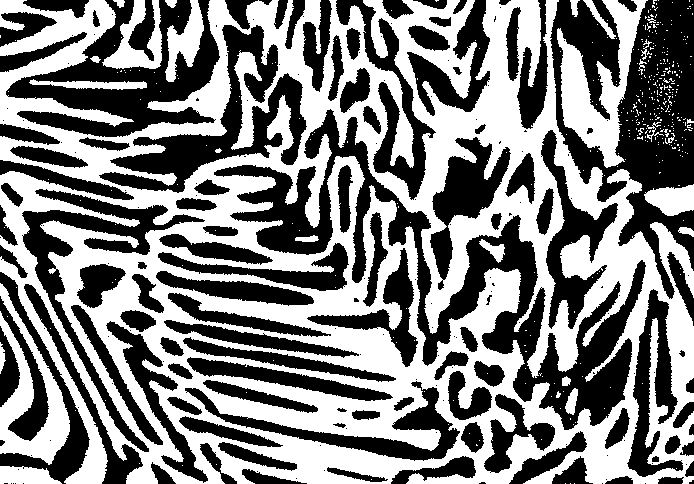

181.0


In [ ]:
ret2, thresh3 = cv2.threshold(cl_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
# ret2 auto
cv2_imshow(thresh3)
print(ret2)

### <a href='https://www.youtube.com/watch?v=WQK_oOWW5Zo'>28 - Thresholding and morphological operations using openCV in Python</a>

1. threshold
2. ero 侵蝕
3. diala 擴張
4. open morphlogyEX = ero + diala
5. close morphlogyEX = diala + ero

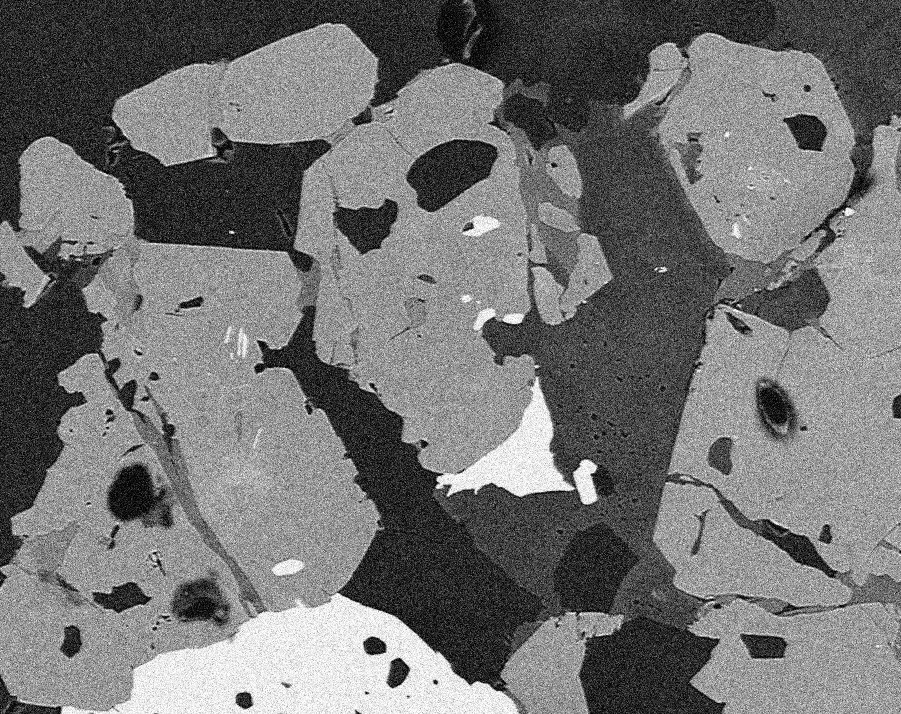

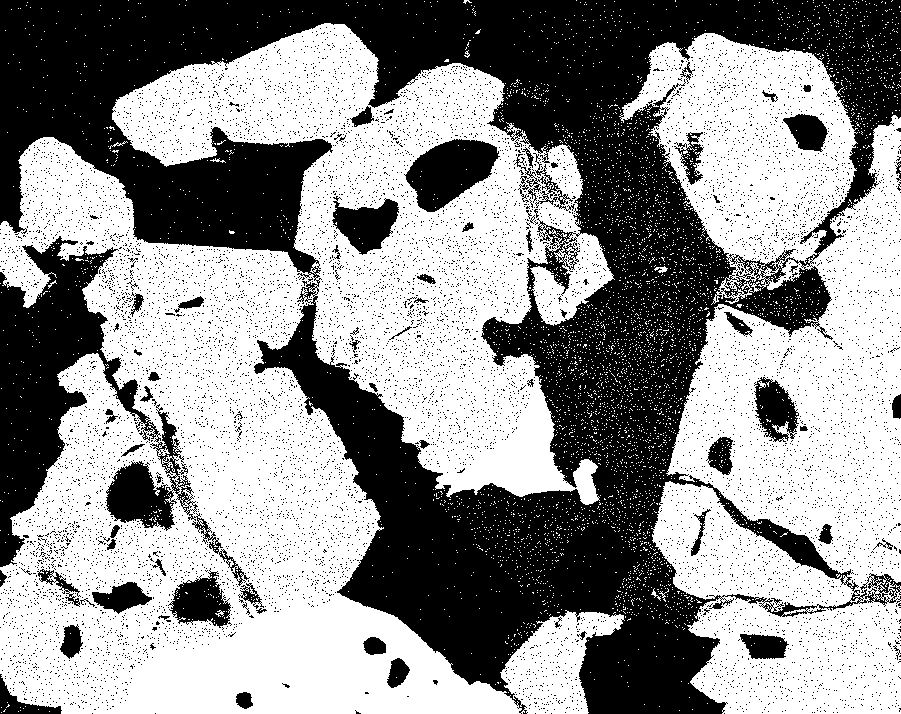

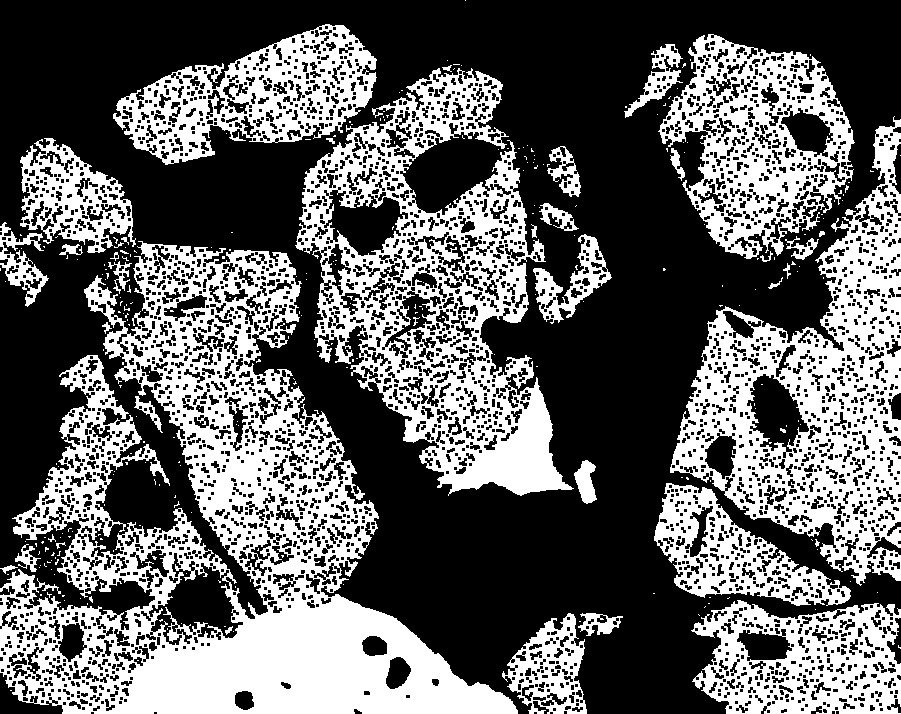

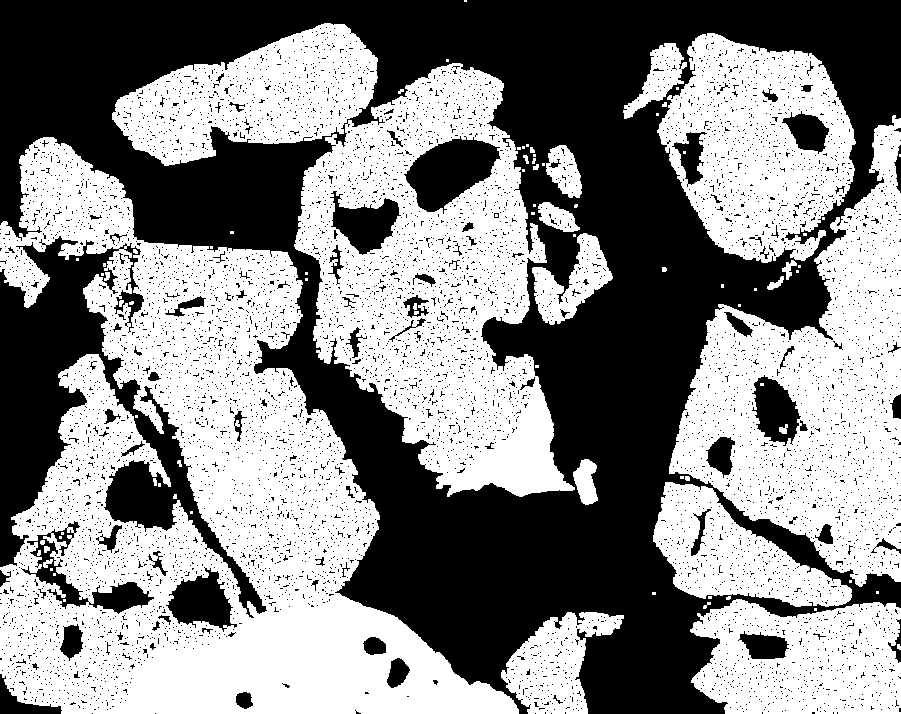

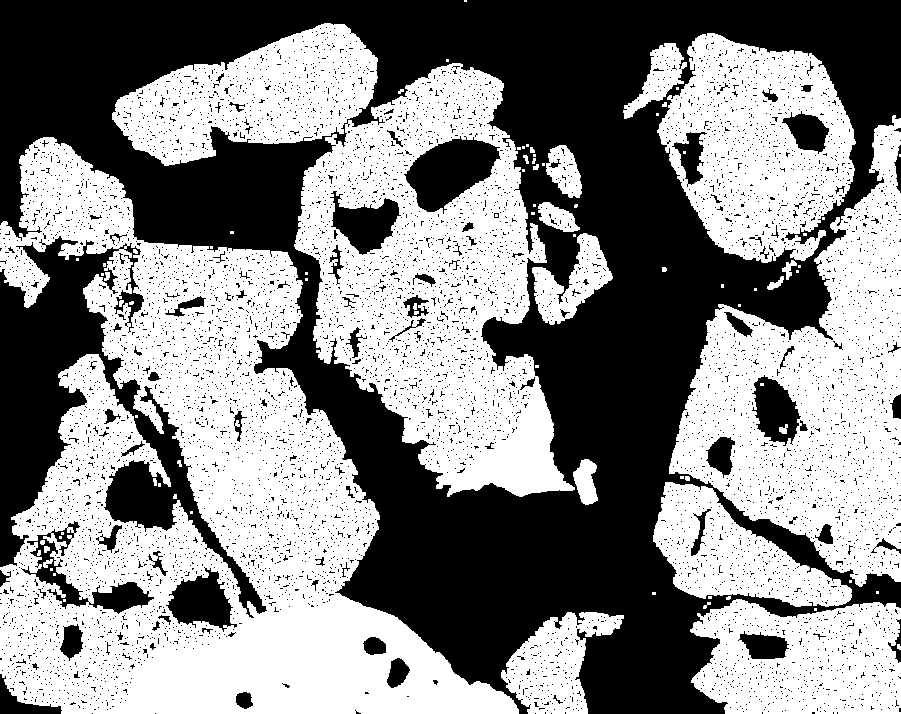

In [ ]:
img = cv2.imread('images/BSE_Google_noisy.jpg', 0)
ret, th = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

kernel = np.ones((3,3), np.uint8)
erosion = cv2.erode(th, kernel, iterations=1)
dialation = cv2.dilate(erosion, kernel, iterations=1)
# dialation = cv2.dilate(erosion, kernel, iterations=2)

opening = cv2.morphologyEx(th, cv2.MORPH_OPEN, kernel)

cv2_imshow(img)
cv2_imshow(th)
cv2_imshow(erosion)
cv2_imshow(dialation)
cv2_imshow(opening)

(array([ 6216.,  3814.,  3070.,  5296.,  3826.,  6341.,  4636.,  7412.,
         5319.,  8351.,  8850.,  6204.,  9545.,  6360., 10059.,  6816.,
        10387.,  6916., 10226.,  7094., 10164., 10139.,  6491.,  9453.,
         6137.,  8935.,  5720.,  8194.,  5154.,  7458.,  7015.,  4492.,
         6404.,  4145.,  6020.,  3971.,  5604.,  3685.,  5379.,  3734.,
         5625.,  5847.,  4187.,  6577.,  4605.,  7373.,  5288.,  8568.,
         6123.,  9900., 10694.,  7590., 12149.,  8488., 13303.,  9042.,
        14342.,  9602., 14650.,  9905., 14914., 14461.,  9381., 13873.,
         8981., 13011.,  8024., 11453.,  7046.,  9893.,  8870.,  5329.,
         7316.,  4434.,  5952.,  3580.,  4626.,  2720.,  3704.,  2165.,
         2863.,  2557.,  1549.,  2246.,  1476.,  2144.,  1422.,  2208.,
         1523.,  2327.,  2393.,  1733.,  2614.,  1893.,  2790.,  1929.,
         2847.,  1767.,  2345.,  4065.]),
 array([  0.  ,   2.55,   5.1 ,   7.65,  10.2 ,  12.75,  15.3 ,  17.85,
         20.4 ,  22.95

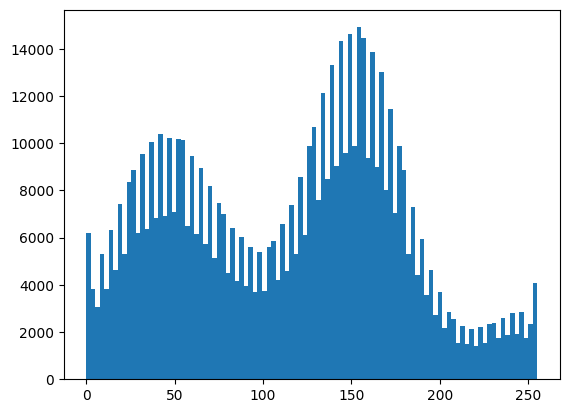

In [ ]:
plt.hist(img.flat, bins=100, range=(0,255))

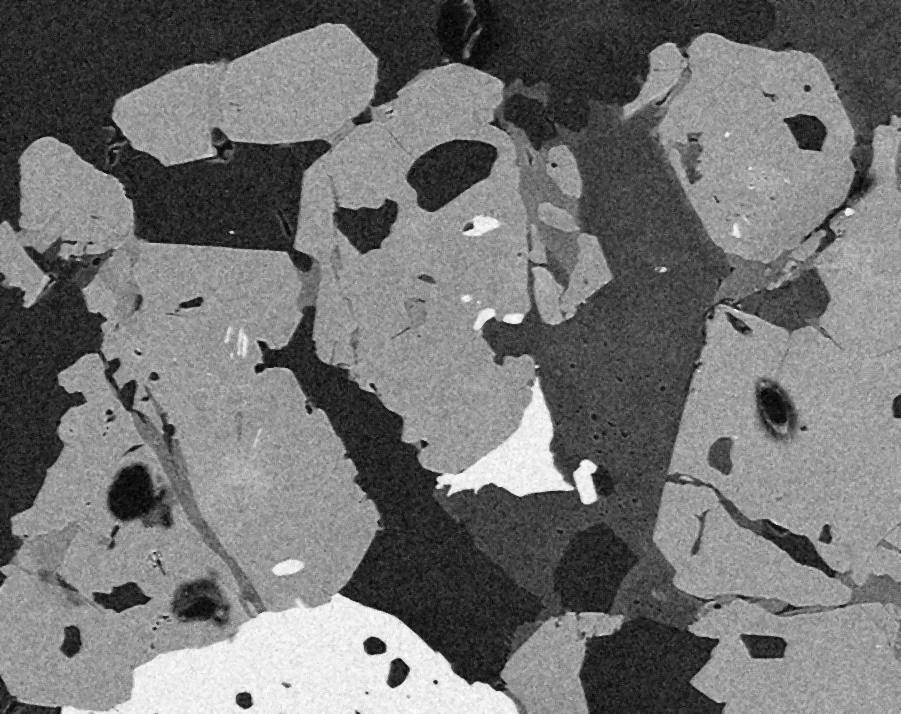

In [ ]:
median = cv2.medianBlur(img, 3)

cv2_imshow(median)

### <a href='https://www.youtube.com/watch?v=DZtUt4bKtmY'>29 - Key points, detectors and descriptors in openCV</a>

1.  Detectors: Harris, Shi-Tomasi, FAST
2.  Detectors & Descriptors: SIFT, SURF(patent issues), ORB
3.  Descriptors: BRIEF

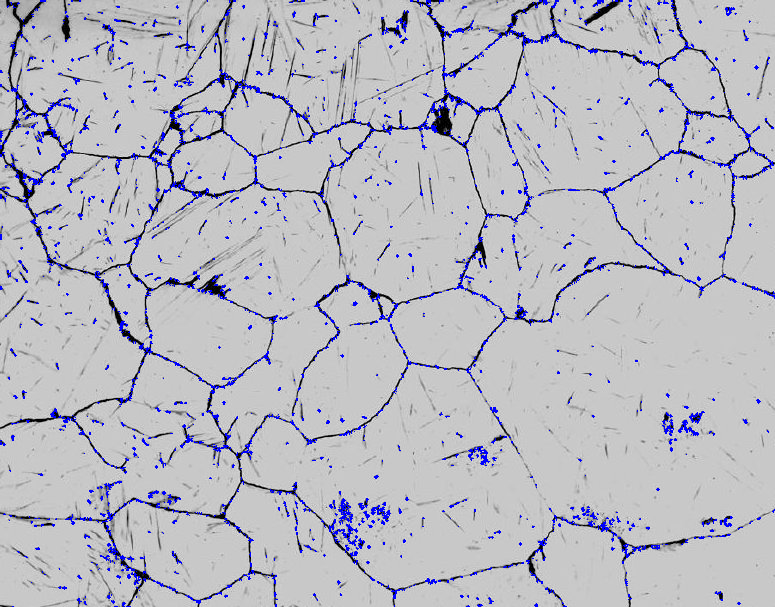

In [ ]:
# Harris
img = cv2.imread('images/grains.jpg')

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)

harris = cv2.cornerHarris(gray, 2, 3, 0.04)
img[harris>0.01*harris.max()] = [255, 0 ,0]

cv2_imshow(img)

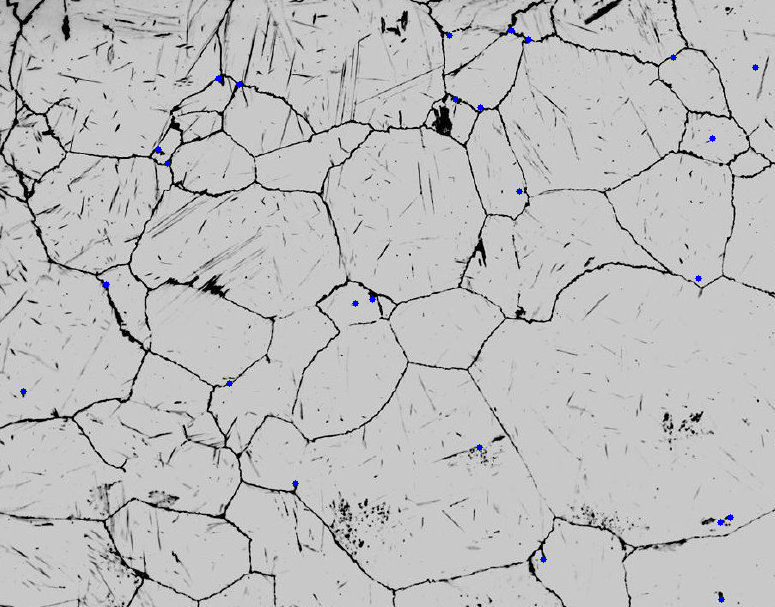

In [ ]:
# Shi-Tomasi
img = cv2.imread('images/grains.jpg')

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

corners = cv2.goodFeaturesToTrack(gray, 25, 0.01, 10)
corners = np.int0(corners)

for i in corners:
  x, y = i.ravel()
  # print(x, y)
  cv2.circle(img, (x,y), 3, 255, -1)

cv2_imshow(img)

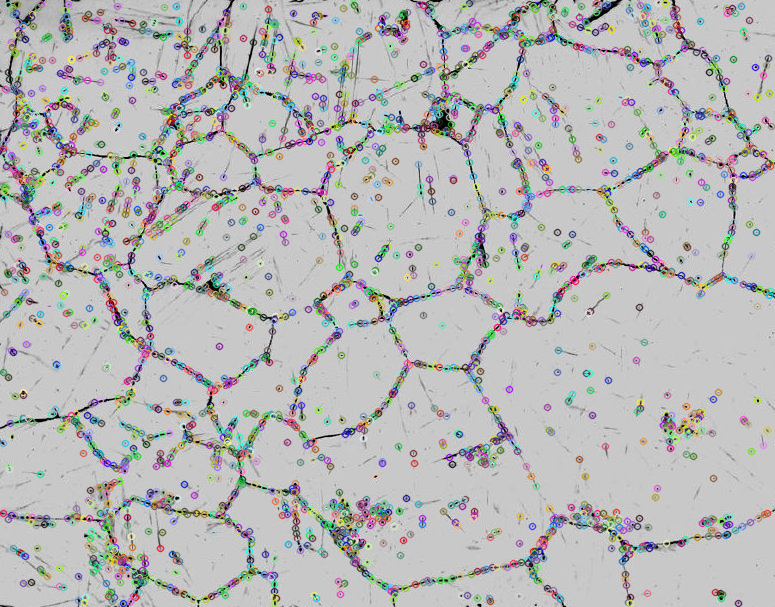

In [ ]:
# FAST
img = cv2.imread('images/grains.jpg')
# Initiate FAST object with default values
detector = cv2.FastFeatureDetector_create(50) #Detects 50 points
kp = detector.detect(img, None)
img2 = cv2.drawKeypoints(img, kp, None, flags=0)

cv2_imshow(img2)

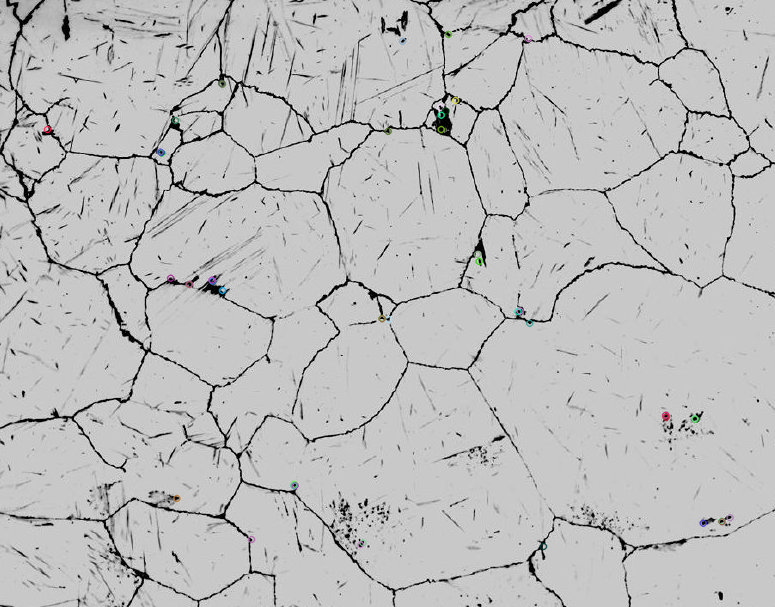

In [ ]:
# ORB (Oriented FAST and Rotated BRIEF)
img = cv2.imread('images/grains.jpg')

orb = cv2.ORB_create(50)

kp, des = orb.detectAndCompute(img, None)
img2 = cv2.drawKeypoints(img, kp, None, flags=0)
cv2_imshow(img2)

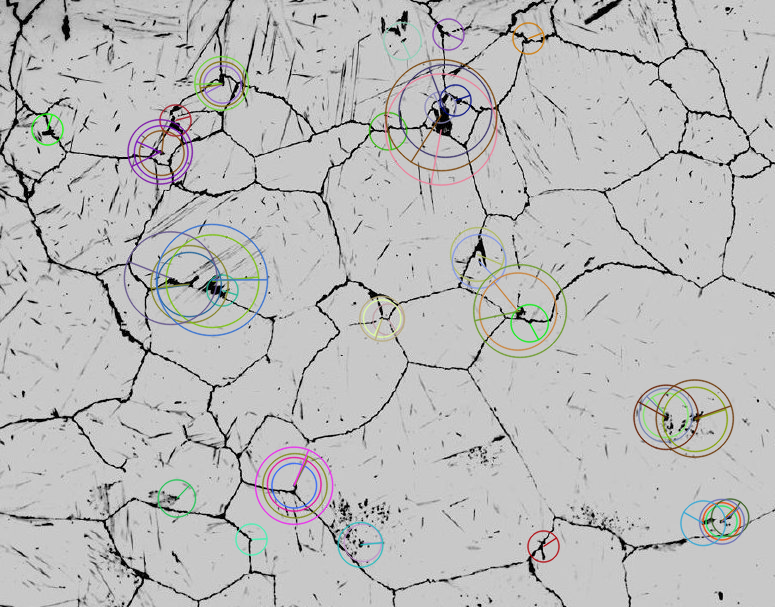

In [ ]:
img2 = cv2.drawKeypoints(img, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(img2)

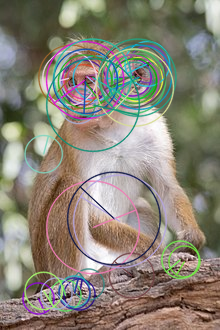

In [ ]:
img = cv2.imread('images/monkey.jpg')

orb = cv2.ORB_create(50)

kp, des = orb.detectAndCompute(img, None)

img2 = cv2.drawKeypoints(img, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(img2)

### <a href='https://www.youtube.com/watch?v=cA8K8dl-E6k'>30 - Image registration using homography in openCV</a>

1.  Import img1
2.  Convert to grey scale
3.  Initiate ORB detector
4.  Find key points and describe them
5.  Match keypoints - Brute force matcher
6.  RANSAC (reject bad keypoints)
7.  Resiter two images (use homology)



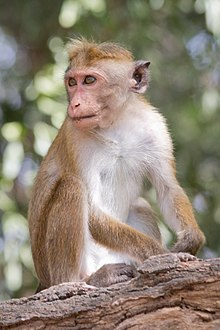

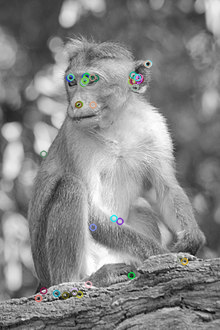

In [ ]:
img = cv2.imread('images/monkey.jpg')
img1 = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

orb = cv2.ORB_create(50)

kp, des = orb.detectAndCompute(img1, None)

img2 = cv2.drawKeypoints(img1, kp, None, flags=None)

cv2_imshow(img)
cv2_imshow(img2)

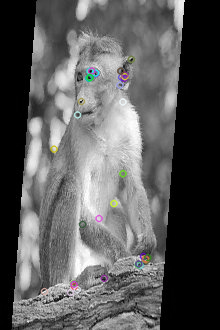

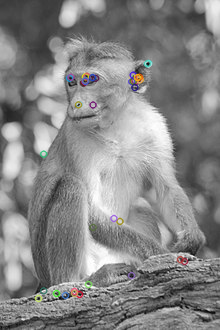

In [ ]:
# ORB
im1 = cv2.imread('images/monkey_distorted.jpg') #Img to be registered
im2 = cv2.imread('images/monkey.jpg') #Reference image

img1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)

# Initiate ORB
orb = cv2.ORB_create(50)

kp1, des1 = orb.detectAndCompute(img1, None)
kp2, des2 = orb.detectAndCompute(img2, None)

img3 = cv2.drawKeypoints(img1, kp1, None, flags=None)
img4 = cv2.drawKeypoints(img2, kp2, None, flags=None)

cv2_imshow(img3)
cv2_imshow(img4)

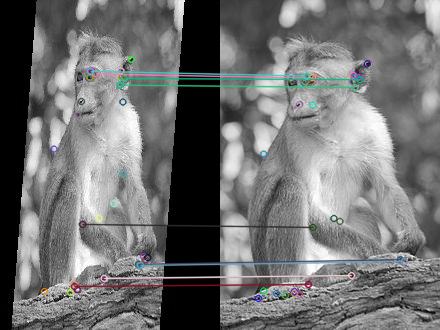

In [ ]:
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)

# MAtch descriptors

matches = matcher.match(des1, des2, None)

matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None)

cv2_imshow(img3)

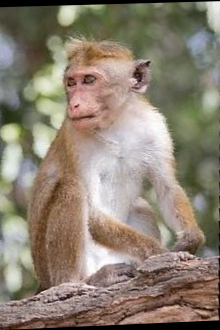

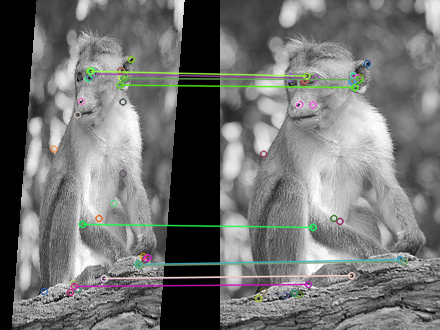

In [ ]:
# ORB
im1 = cv2.imread('images/monkey_distorted.jpg') #Img to be registered
im2 = cv2.imread('images/monkey.jpg') #Reference image

img1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)

# Initiate ORB
orb = cv2.ORB_create(50)

kp1, des1 = orb.detectAndCompute(img1, None)
kp2, des2 = orb.detectAndCompute(img2, None)

matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)

# MAtch descriptors

matches = matcher.match(des1, des2, None)

matches = sorted(matches, key = lambda x:x.distance)

points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i , match in enumerate(matches):
  points1[i, :] = kp1[match.queryIdx].pt
  points2[i, :] = kp2[match.trainIdx].pt

# print(kp1)
# print(points1)

h, mask = cv2.findHomography(points1, points2, cv2.RANSAC)

# Use Homography

height, width, channels = im2.shape

im1Reg = cv2.warpPerspective(im1, h, (width, height))
img3 = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None)

cv2_imshow(im1Reg)
cv2_imshow(img3)

## Analysis

31-35

# Data Processing
 36-42

## Basic

### <a href='https://www.youtube.com/watch?v=Dx8ixwTfWz0'>31 - A few ways to read and write csv files in Python</a>

In [ ]:
with open ('fruits1.csv') as myFile:
  reader = csv.reader(myFile)
  for row in reader:
    print(row)

# Machine Learning

## Regression
44-49

## Clustering
50-53